# Exploration of dimensionality reduction for image analysis
**Goal:**  Umap projections of all cells, with and without morphology features
**Input:**  Adata objects from 991 and 992     
**Output:** Plots 
**Author:** Jose Nimo    
**Date_of_creation:** 12.05.2025     
**Date_of_latest_modification:** 12.05.2025    
**Status:** Started

## imports

In [1]:
import os,sys,time
from loguru import logger 

# import scimap as sm

import numpy as np
import pandas as pd
import shapely
import geopandas as gpd
import anndata as ad

import pyarrow
import ast

#plotting
import matplotlib.pyplot as plt
import seaborn as sns

#custom functions
sys.path.append(os.path.abspath('/Users/jnimoca/Jose_BI/1_Pipelines/openDVP/src/'))
from opendvp import anndata_utils, filtering, imaging, utils
import importlib

from itertools import product

from sklearn.preprocessing import StandardScaler, MinMaxScaler

import umap
from sklearn.model_selection import ParameterGrid
from tqdm import tqdm

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

for package in [np,pd,gpd,ad]:
    print(f"{package.__name__} {package.__version__}")

numpy 1.26.4
pandas 2.2.3
geopandas 1.0.1
anndata 0.10.9


## functions 

In [25]:
from tqdm import tqdm
from sklearn.model_selection import ParameterGrid
import umap
import pandas as pd

def run_umap_grid_search_df(df, param_grid):
    rows = []
    grid = list(ParameterGrid(param_grid))
    
    for umap_params in tqdm(grid, desc="UMAP Grid Search"):
        embedding = umap.UMAP(**umap_params).fit_transform(df)
        row = {"embedding": embedding, **umap_params}
        rows.append(row)
    
    result_df = pd.DataFrame(rows)
    return result_df

In [ ]:
def plot_umap_param_grid(results_df: pd.DataFrame,
                         labels: pd.Series,
                         color_map: dict,
                         param_columns: list,
                         ncols: int = 3,
                         point_size: int = 5):
    
    assert isinstance(labels, pd.Series), "Labels must be a pandas Series"
    assert len(labels) == len(results_df.iloc[0]["embedding"]), "Labels must match embedding length"
    assert all(col in results_df.columns for col in param_columns), "Some param_columns are missing in results"

    color_vals = labels.values  # assume order alignment
    unique_param_values = [sorted(results_df[col].unique()) for col in param_columns]

    if len(param_columns) > 3:
        raise ValueError("Maximum 3 parameter columns supported for plotting (for now).")

    # Determine grouping strategy
    if len(param_columns) <= 2:
        # Use all results directly in one grid
        sub_results = results_df.copy()
        group_key = None
    else:
        # Separate plots per unique value of the third parameter
        group_key = param_columns[2]
        grouped = results_df.groupby(group_key)

    def make_title(row, keys):
        return ', '.join(f"{k}={row[k]}" for k in keys)

    def plot_grid(subset_df, title_prefix=""):
        n_plots = len(subset_df)
        nrows = math.ceil(n_plots / ncols)
        fig, axes = plt.subplots(nrows, ncols, figsize=(5 * ncols, 4 * nrows))
        axes = np.array(axes).flatten()

        for ax in axes[n_plots:]:
            ax.axis("off")

        for i, (_, row) in enumerate(subset_df.iterrows()):
            embedding = row["embedding"]
            ax = axes[i]
            title = make_title(row, param_columns[:2])
            for category in np.unique(color_vals):
                mask = color_vals == category
                ax.scatter(embedding[mask, 0], embedding[mask, 1],
                           s=point_size,
                           color=color_map.get(category, "gray"),
                           label=category,
                           alpha=0.7,
                           edgecolor='none')
            ax.set_title(title)
            ax.set_xticks([])
            ax.set_yticks([])

        handles = [plt.Line2D([0], [0], marker='o', color='w',
                              label=cat, markersize=6,
                              markerfacecolor=color_map.get(cat, 'gray'))
                   for cat in color_map.keys()]

        fig.legend(handles=handles, loc='lower center', ncol=len(color_map), frameon=False)
        plt.tight_layout(rect=[0, 0.05, 1, 1])
        if title_prefix:
            fig.suptitle(f"{group_key} = {title_prefix}", fontsize=16)
            plt.subplots_adjust(top=0.92)

        plt.show()

    if group_key:
        for key_val, subdf in grouped:
            plot_grid(subdf, title_prefix=key_val)
    else:
        plot_grid(sub_results)

In [61]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

def plot_single_umap_result(embedding: np.ndarray,
                             labels: pd.Series,
                             color_map: dict,
                             title: str = "",
                             point_size: int = 5,
                             figsize: tuple = (6, 5)):
    """
    Plot a single UMAP embedding with colored labels.

    Parameters:
        embedding (np.ndarray): 2D UMAP embedding (n_samples, 2).
        labels (pd.Series): Labels per point, same order as embedding.
        color_map (dict): Category → color.
        title (str): Plot title.
        point_size (int): Size of scatter points.
        figsize (tuple): Size of figure (width, height).
    """
    assert isinstance(labels, pd.Series), "Labels must be a pandas Series"
    assert embedding.shape[0] == len(labels), "Embedding and labels must have the same number of rows"

    color_vals = labels.values

    fig, ax = plt.subplots(figsize=figsize)

    for category in np.unique(color_vals):
        mask = color_vals == category
        ax.scatter(embedding[mask, 0], embedding[mask, 1],
                   s=point_size,
                   color=color_map.get(category, "gray"),
                   label=category,
                   alpha=0.7,
                   edgecolor='none')

    ax.set_title(title)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.legend(title="Labels", frameon=False, bbox_to_anchor=(1.05, 1), loc="upper left")
    plt.tight_layout()
    plt.show()

In [69]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

def plot_single_umap_result(embedding: np.ndarray,
                             labels: pd.Series,
                             color_map: dict,
                             title: str = "",
                             point_size: int = 5,
                             figsize: tuple = (6, 5)):
    """
    Plot a single UMAP embedding with colored labels.

    Parameters:
        embedding (np.ndarray): 2D UMAP embedding (n_samples, 2).
        labels (pd.Series): Labels per point, same order as embedding.
        color_map (dict): Mapping from label → color.
        title (str): Plot title.
        point_size (int): Size of scatter points.
        figsize (tuple): Size of figure (width, height).
    """
    assert isinstance(labels, pd.Series), "Labels must be a pandas Series"
    assert embedding.shape[0] == len(labels), "Embedding and labels must have the same number of rows"

    color_vals = labels.values
    unique_labels = np.unique(color_vals)

    fig, ax = plt.subplots(figsize=figsize)

    for category in unique_labels:
        mask = color_vals == category
        ax.scatter(embedding[mask, 0], embedding[mask, 1],
                   s=point_size,
                   color=color_map.get(category, "gray"),
                   label=category,
                   alpha=0.7,
                   edgecolor='none')

    # Build custom legend using the exact colors from color_map
    handles = [
        plt.Line2D([0], [0], marker='o', linestyle='None',
                   markerfacecolor=color_map.get(cat, 'gray'),
                   markeredgecolor='none', markersize=6, label=str(cat))
        for cat in unique_labels
    ]

    ax.set_title(title)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.legend(handles=handles, title="Labels", frameon=False,
              bbox_to_anchor=(1.05, 1), loc="upper left")
    plt.tight_layout()
    plt.show()

In [ ]:
# PCA functions

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import math

from sklearn.model_selection import ParameterGrid
import numpy as np
import pandas as pd

def run_umap_grid_search_df(X_pca, param_grid, n_pcs_list, random_state=42):
    rows = []

    for n_pcs in n_pcs_list:
        X_sub = X_pca[:, :n_pcs]

        for umap_params in ParameterGrid(param_grid):
            umap_params_with_seed = dict(umap_params)
            umap_params_with_seed["random_state"] = random_state

            embedding = umap.UMAP(**umap_params_with_seed).fit_transform(X_sub)

            row = {
                "embedding": embedding,
                "n_pcs": n_pcs,
                **umap_params
            }
            rows.append(row)

    df = pd.DataFrame(rows)
    return df

def plot_umap_grid_from_df(
    df,
    labels: pd.Series,
    color_map: dict,
    grid_params: list,
    param_values: dict = None,
    point_size=5,
    ncols=3
):
    assert len(grid_params) in [1, 2, 3], "grid_params must be 1, 2, or 3 parameters"
    assert all(p in df.columns for p in grid_params), "All grid_params must be in df"

    if param_values is None:
        param_values = {p: sorted(df[p].unique()) for p in grid_params}
    else:
        param_values = {
            p: param_values.get(p, sorted(df[p].unique()))
            for p in grid_params
        }

    # Handle third param (looping outer dimension)
    outer_loop_param = grid_params[2] if len(grid_params) == 3 else None
    outer_values = param_values[outer_loop_param] if outer_loop_param else [None]

    for outer_val in outer_values:
        # Subset for this loop
        if outer_loop_param:
            subset = df[df[outer_loop_param] == outer_val]
        else:
            subset = df

        # Build grid (rows by first param, columns by second param)
        p1 = grid_params[0]
        p2 = grid_params[1] if len(grid_params) >= 2 else None

        nrows = len(param_values[p1])
        ncols_eff = len(param_values[p2]) if p2 else 1

        fig, axes = plt.subplots(
            nrows=nrows,
            ncols=ncols_eff,
            figsize=(4 * ncols_eff, 4 * nrows),
            squeeze=False
        )

        for i, val1 in enumerate(param_values[p1]):
            for j, val2 in enumerate(param_values[p2]) if p2 else [(0, None)]:
                if p2:
                    match = (subset[p1] == val1) & (subset[p2] == val2)
                else:
                    match = subset[p1] == val1

                row_df = subset[match]

                if row_df.empty:
                    axes[i, j].axis("off")
                    continue

                # Assumes only one match per combination
                row = row_df.iloc[0]
                embedding = row["embedding"]

                # Map labels to color
                for cat in np.unique(labels):
                    mask = labels == cat
                    axes[i, j].scatter(
                        embedding[mask, 0],
                        embedding[mask, 1],
                        s=point_size,
                        color=color_map.get(cat, "gray"),
                        label=cat,
                        alpha=0.7,
                        edgecolor='none'
                    )

                title = f"{p1}={val1}"
                if p2:
                    title += f", {p2}={val2}"
                if outer_loop_param:
                    title += f"\n{outer_loop_param}={outer_val}"
                axes[i, j].set_title(title)
                axes[i, j].set_xticks([])
                axes[i, j].set_yticks([])

        # Legend outside plot
        handles = [
            plt.Line2D([0], [0], marker='o', color='w',
                       label=cat, markersize=6,
                       markerfacecolor=color_map.get(cat, 'gray'))
            for cat in color_map
        ]
        fig.legend(handles=handles, loc='lower center', ncol=len(color_map), frameon=False)
        fig.tight_layout(rect=[0, 0.05, 1, 1])
        plt.show()

## Load data

In [12]:
import json
with open("../assets/pheno_colors.json") as f:
    color_dict = json.load(f)

In [244]:
adata_991 = ad.read_h5ad("../data/perSample/991/adata_checkpoints/7_adata_pheno/20250302_1823_7_adata_pheno_adata.h5ad")
adata_992 = ad.read_h5ad("../data/perSample/992/adata_checkpoints/7_adata_pheno/20250303_1112_7_adata_pheno_adata.h5ad")

In [3]:
adata_991

AnnData object with n_obs × n_vars = 610182 × 8
    obs: 'CellID', 'Y_centroid', 'X_centroid', 'Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity', '991', 'artefact', 'mean_DAPI_bg_above_100', 'mean_DAPI_bg_below_3162', 'Area_filter_nottoobig', 'Area_filter_nottoolow', 'Area_filter', 'DAPI_ratio', 'DAPI_ratio_pass_nottoolow', 'DAPI_ratio_pass_nottoohigh', 'DAPI_ratio_pass', 'filtering', 'imageid', 'phenotype'
    var: 'math', 'marker'
    uns: 'gates'
    layers: 'log'

These datasets are filtered, only the features used for phenotyping are present.
To use morphology markers I gotta map these phenotypes via CellID to raw data, and then umap them.

map all features to phenotyped cells by Cell ID    
[ ] get adata with all features and Cell ID 

In [248]:
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/0_init/20250302_1751_0_init_adata.h5ad")
adata.var_names

/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


Index(['std_750_bg', 'std_647_bg', 'std_555_bg', 'std_488_bg', 'std_DAPI_bg',
       'std_Vimentin', 'std_CD3e', 'std_panCK', 'std_CD8', 'std_DAPI_1',
       'std_COL1A1', 'std_CD20', 'std_CD68', 'std_Ki67', 'std_DAPI_2',
       'mean_750_bg', 'mean_647_bg', 'mean_555_bg', 'mean_488_bg',
       'mean_DAPI_bg', 'mean_Vimentin', 'mean_CD3e', 'mean_panCK', 'mean_CD8',
       'mean_DAPI_1', 'mean_COL1A1', 'mean_CD20', 'mean_CD68', 'mean_Ki67',
       'mean_DAPI_2', 'quantile25_750_bg', 'quantile25_647_bg',
       'quantile25_555_bg', 'quantile25_488_bg', 'quantile25_DAPI_bg',
       'quantile25_Vimentin', 'quantile25_CD3e', 'quantile25_panCK',
       'quantile25_CD8', 'quantile25_DAPI_1', 'quantile25_COL1A1',
       'quantile25_CD20', 'quantile25_CD68', 'quantile25_Ki67',
       'quantile25_DAPI_2', 'quantile50_750_bg', 'quantile50_647_bg',
       'quantile50_555_bg', 'quantile50_488_bg', 'quantile50_DAPI_bg',
       'quantile50_Vimentin', 'quantile50_CD3e', 'quantile50_panCK',
       'qua

# attempt to run umap in dummy dataset

In [14]:
import umap
import scanpy as sc
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

In [35]:
# 1. Load PBMC3k dataset from Scanpy
adata = sc.datasets.pbmc3k()
# 2. Preprocessing: Filter & normalize
sc.pp.filter_genes(adata, min_cells=3)
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

sc.pp.highly_variable_genes(adata, n_top_genes=500, subset=True)

In [36]:
# 3. Standardize features (Z-score)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(adata.X.toarray())  # .X is sparse

In [37]:
# 4. Run UMAP
reducer = umap.UMAP(n_components=2, random_state=42)
embedding = reducer.fit_transform(X_scaled)

/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [40]:
embedding.shape

(2700, 2)

In [38]:
# 5. Save to AnnData
adata.obsm["X_umap_custom"] = embedding
adata.uns["umap_params_custom"] = reducer.get_params()

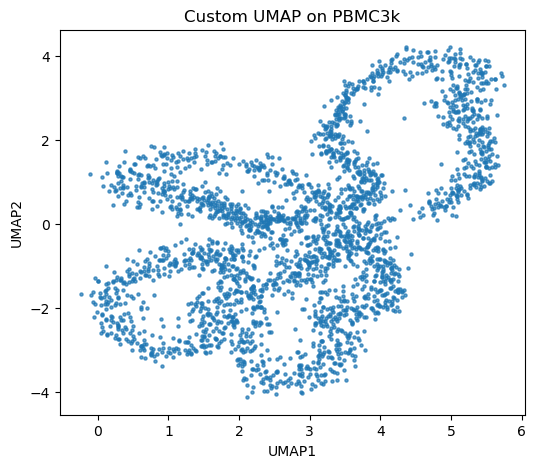

In [39]:
# 6. Plot
plt.figure(figsize=(6, 5))
plt.scatter(embedding[:, 0], embedding[:, 1], s=5, alpha=0.7)
plt.title("Custom UMAP on PBMC3k")
plt.xlabel("UMAP1")
plt.ylabel("UMAP2")
plt.show()

In [45]:
import scanpy as sc
import umap
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import numpy as np

# Load and preprocess PBMC3k dataset
adata = sc.datasets.pbmc3k()
sc.pp.filter_genes(adata, min_cells=3)
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
# sc.pp.highly_variable_genes(adata, n_top_genes=500, subset=True)

In [46]:
# Z-score standardization (dense needed)
X = adata.X.toarray()  # Be careful with memory on large data
X_scaled = StandardScaler().fit_transform(X)

In [47]:
# Define grid parameters
n_neighbors_list = [5, 15, 50]
min_dist_list = [0.1, 0.5, 0.9]

/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed

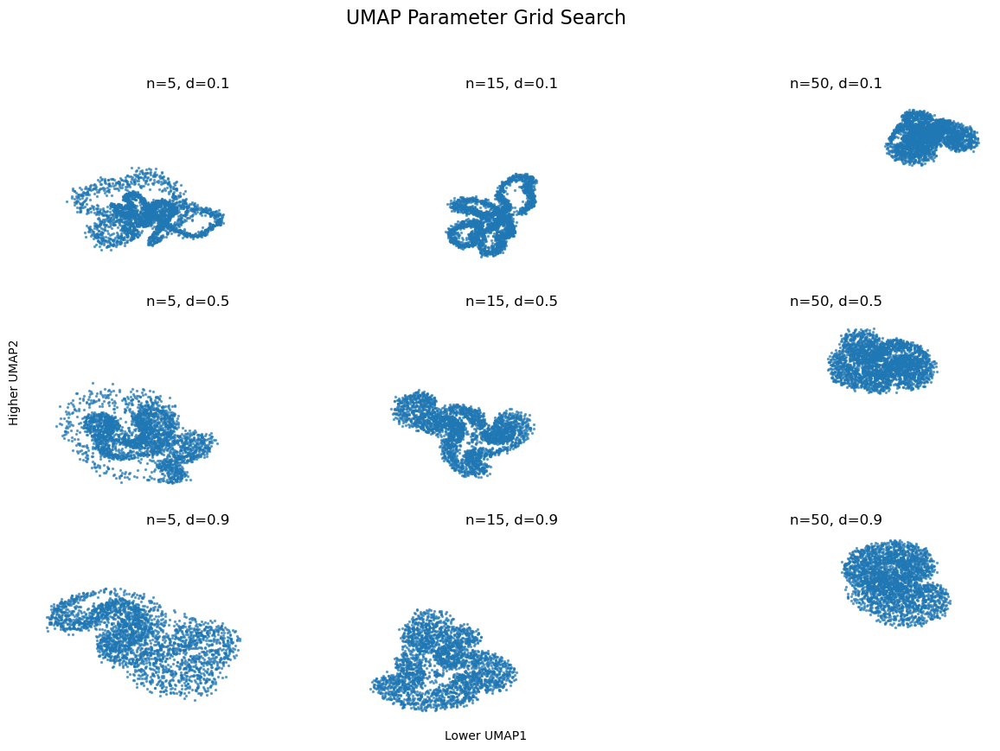

In [48]:
# Create plot grid
fig, axes = plt.subplots(len(min_dist_list), len(n_neighbors_list), figsize=(12, 9), sharex=True, sharey=True)

# Loop over grid
for i, min_dist in enumerate(min_dist_list):
    for j, n_neighbors in enumerate(n_neighbors_list):
        reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, random_state=42)
        embedding = reducer.fit_transform(X_scaled)

        ax = axes[i, j]
        ax.scatter(embedding[:, 0], embedding[:, 1], s=2, alpha=0.6)
        ax.set_title(f"n={n_neighbors}, d={min_dist}")
        ax.axis('off')

# Global labels
fig.suptitle("UMAP Parameter Grid Search", fontsize=16)
fig.text(0.5, 0.04, "Lower UMAP1", ha='center')
fig.text(0.04, 0.5, "Higher UMAP2", va='center', rotation='vertical')
plt.tight_layout(rect=[0.05, 0.05, 1, 0.95])
plt.show()

In [ ]:
# ok lets get my actual dataset ready

In [49]:
adata_991 = ad.read_h5ad("../data/perSample/991/adata_checkpoints/7_adata_pheno/20250302_1823_7_adata_pheno_adata.h5ad")

In [50]:
adata_991

AnnData object with n_obs × n_vars = 610182 × 8
    obs: 'CellID', 'Y_centroid', 'X_centroid', 'Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity', '991', 'artefact', 'mean_DAPI_bg_above_100', 'mean_DAPI_bg_below_3162', 'Area_filter_nottoobig', 'Area_filter_nottoolow', 'Area_filter', 'DAPI_ratio', 'DAPI_ratio_pass_nottoolow', 'DAPI_ratio_pass_nottoohigh', 'DAPI_ratio_pass', 'filtering', 'imageid', 'phenotype'
    var: 'math', 'marker'
    uns: 'gates'
    layers: 'log'

In [85]:
df_markers = pd.DataFrame(data=adata_991.X, columns=adata_991.var_names, index=adata_991.obs['CellID'])

In [86]:
columns = ['CellID', 'Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent']
df_to_scale = adata_991.obs[columns].copy()
df_to_scale = df_to_scale.set_index('CellID')

In [87]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df_scaled = scaler.fit_transform(X=df_to_scale.values)
df_scaled.shape

(610182, 6)

In [88]:
df_morpho = pd.DataFrame(data=df_scaled, columns=df_to_scale.columns, index=df_to_scale.index)
df_morpho.head()

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,Orientation,Extent
CellID,,,,,,
1,0.243202,0.635682,0.270999,0.969196,0.014584,0.481331
2,0.253644,0.228982,0.400706,0.620663,0.550931,0.232230
3,0.135741,0.143535,0.321907,0.528427,0.389660,0.178409
4,0.198825,0.318514,0.236022,0.902650,0.039377,0.240158
5,0.708070,0.513372,0.654609,0.740551,0.579961,0.527224


In [119]:
df_m = pd.merge(left=df_markers, right=df_morpho, left_on="CellID", right_on="CellID")

In [120]:
df_m

,mean_Vimentin,mean_CD3e,mean_panCK,mean_CD8,mean_COL1A1,mean_CD20,mean_CD68,mean_Ki67,Area,MajorAxisLength,MinorAxisLength,Eccentricity,Orientation,Extent
CellID,,,,,,,,,,,,,,
1,0.217430,0.445292,0.706378,0.443221,0.457555,0.392043,0.299051,0.000000,0.243202,0.635682,0.270999,0.969196,0.014584,0.481331
2,0.232569,0.441189,0.635352,0.423866,0.542440,0.425889,0.338904,0.000000,0.253644,0.228982,0.400706,0.620663,0.550931,0.232230
3,0.215473,0.466213,0.794898,0.445378,0.473647,0.402801,0.311815,0.000000,0.135741,0.143535,0.321907,0.528427,0.389660,0.178409
4,0.309152,0.556337,0.227288,0.466315,0.443738,0.431272,0.305019,0.000000,0.198825,0.318514,0.236022,0.902650,0.039377,0.240158
5,0.290441,0.483283,0.701336,0.456075,0.467879,0.413881,0.338755,0.000000,0.708070,0.513372,0.654609,0.740551,0.579961,0.527224
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
685801,0.349347,0.580561,0.616782,0.481668,0.648872,0.418773,0.394006,0.005254,0.147705,0.279106,0.195043,0.909245,0.819187,0.210104
685802,0.365076,0.540715,0.739696,0.554223,0.465899,0.404583,0.345634,0.000000,0.146835,0.156808,0.320208,0.582892,0.923399,0.172047
685803,0.440463,0.730069,0.339847,0.553126,0.552363,0.418617,0.399508,0.000000,0.079835,0.084360,0.261284,0.429189,0.812918,0.096819


In [69]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from itertools import product

def plot_umap_grid_results(
    grid_results,
    param_names=("n_neighbors", "min_dist"),
    color_series: pd.Series = None,
    color_dict: dict = None,
    figsize_per_plot=(5, 5),
    point_size=10
):
    """
    Plot UMAP embeddings from grid search results in a parameter grid layout.

    Parameters:
    - grid_results: list of dicts with keys 'embedding' and 'params'.
    - param_names: tuple of two parameter names used in the grid search.
    - color_series: pd.Series with index matching data points.
    - color_dict: optional dict mapping categorical labels to colors.
    - figsize_per_plot: tuple (width, height) per subplot.
    - point_size: marker size.
    """
    # Determine unique parameter values
    param_values = {p: sorted({r["params"][p] for r in grid_results}) for p in param_names}
    n_rows, n_cols = len(param_values[param_names[0]]), len(param_values[param_names[1]])

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(figsize_per_plot[0]*n_cols, figsize_per_plot[1]*n_rows), squeeze=False)

    # Create lookup for parameter combinations
    param_grid = {(r["params"][param_names[0]], r["params"][param_names[1]]): r for r in grid_results}

    for i, val1 in enumerate(param_values[param_names[0]]):
        for j, val2 in enumerate(param_values[param_names[1]]):
            ax = axes[i][j]
            result = param_grid.get((val1, val2))
            if result is None:
                ax.axis("off")
                continue

            emb = pd.DataFrame(result["embedding"], columns=["UMAP1", "UMAP2"])
            if color_series is not None:
                emb["category"] = color_series.values
                sns.scatterplot(
                    data=emb,
                    x="UMAP1", y="UMAP2",
                    hue="category",
                    palette=color_dict,
                    ax=ax,
                    s=point_size,
                    linewidth=0,
                    legend=False
                )
            else:
                ax.scatter(emb["UMAP1"], emb["UMAP2"], s=point_size, c='black')

            ax.set_title(f'{param_names[0]}={val1}, {param_names[1]}={val2}')
            ax.set_xticks([])
            ax.set_yticks([])

    # Add global legend if applicable
    if color_series is not None:
        handles, labels = ax.get_legend_handles_labels()
        if handles:
            fig.legend(handles, labels, loc="center right", title=color_series.name)

    plt.tight_layout(rect=[0, 0, 0.9, 1])
    plt.show()

In [121]:
df = pd.merge(left=df_m, right=adata_991.obs[['CellID', "phenotype"]], left_on="CellID", right_on="CellID")
df.set_index("CellID", inplace=True)
df

,mean_Vimentin,mean_CD3e,mean_panCK,mean_CD8,mean_COL1A1,mean_CD20,mean_CD68,mean_Ki67,Area,MajorAxisLength,MinorAxisLength,Eccentricity,Orientation,Extent,phenotype
CellID,,,,,,,,,,,,,,,
1,0.217430,0.445292,0.706378,0.443221,0.457555,0.392043,0.299051,0.000000,0.243202,0.635682,0.270999,0.969196,0.014584,0.481331,Cancer_cells
2,0.232569,0.441189,0.635352,0.423866,0.542440,0.425889,0.338904,0.000000,0.253644,0.228982,0.400706,0.620663,0.550931,0.232230,Cancer_cells
3,0.215473,0.466213,0.794898,0.445378,0.473647,0.402801,0.311815,0.000000,0.135741,0.143535,0.321907,0.528427,0.389660,0.178409,Cancer_cells
4,0.309152,0.556337,0.227288,0.466315,0.443738,0.431272,0.305019,0.000000,0.198825,0.318514,0.236022,0.902650,0.039377,0.240158,CD4_Tcells
5,0.290441,0.483283,0.701336,0.456075,0.467879,0.413881,0.338755,0.000000,0.708070,0.513372,0.654609,0.740551,0.579961,0.527224,Cancer_cells
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
685801,0.349347,0.580561,0.616782,0.481668,0.648872,0.418773,0.394006,0.005254,0.147705,0.279106,0.195043,0.909245,0.819187,0.210104,COL1A1_cells
685802,0.365076,0.540715,0.739696,0.554223,0.465899,0.404583,0.345634,0.000000,0.146835,0.156808,0.320208,0.582892,0.923399,0.172047,Cancer_cells
685803,0.440463,0.730069,0.339847,0.553126,0.552363,0.418617,0.399508,0.000000,0.079835,0.084360,0.261284,0.429189,0.812918,0.096819,CD8_Tcells


In [132]:
subsample = df.sample(10000)
ss_X = subsample.iloc[:,:-1]
ss_label = subsample.iloc[:,-1]

In [ ]:
from tqdm import tqdm
from sklearn.model_selection import ParameterGrid
import umap

param_grid = {
    'n_neighbors': [5, 25, 50, 100],
    'min_dist': [0.001, 0.01, 0.1, 0.2, 0.5],
    'n_components': [2],
    'metric': ['euclidean']
}

grid = list(ParameterGrid(param_grid))

results = []
with tqdm(total=len(grid), desc="UMAP grid search") as pbar:
    for params in grid:
        reducer = umap.UMAP(**params)
        embedding = reducer.fit_transform(ss_X)
        results.append({
            'embedding': embedding,
            'params': params,
        })
        
        # Update progress bar with current params (brief version)
        brief_params = {k: params[k] for k in ['n_neighbors', 'min_dist']}
        pbar.set_postfix(brief_params)
        pbar.update(1)

UMAP grid search:   0%|          | 0/25 [00:00<?, ?it/s]/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely

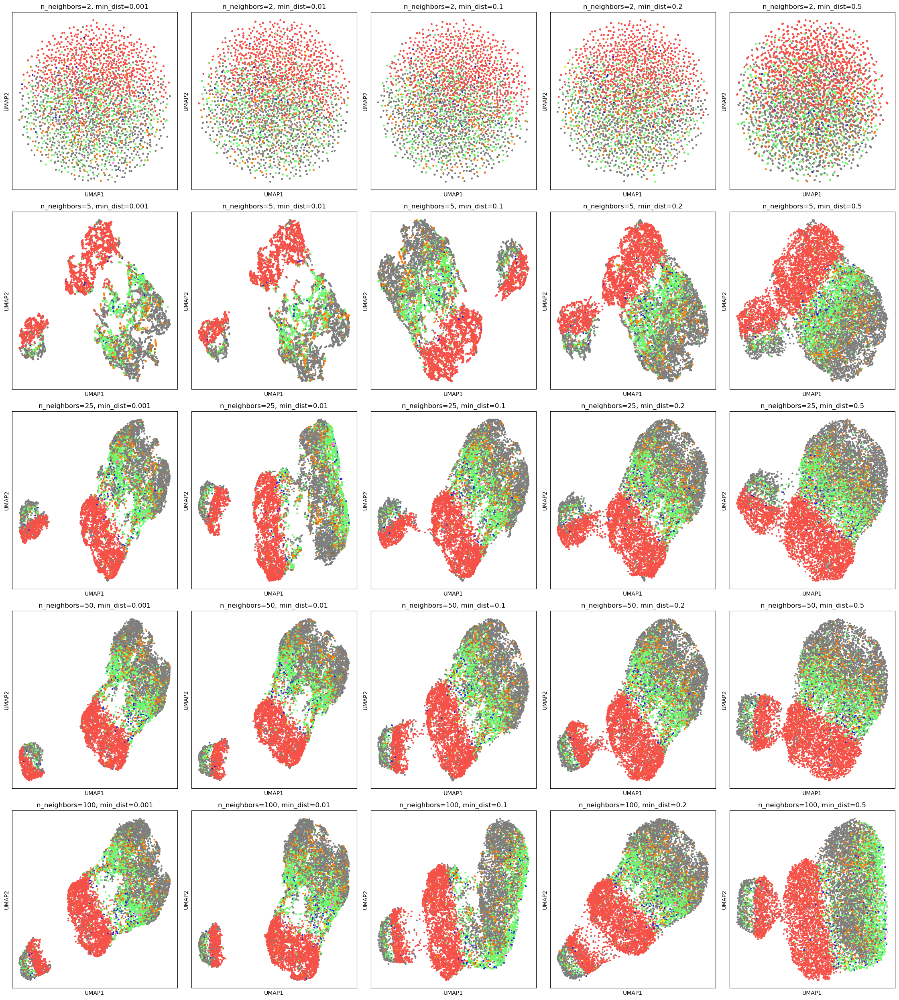

In [135]:
plot_umap_grid_results(
    grid_results=results,
    param_names=("n_neighbors", "min_dist"),
    color_series=ss_label,
    color_dict=color_dict,
    )

In [137]:
subsample = df.sample(100000)
ss_X = subsample.iloc[:,:-1]
ss_label = subsample.iloc[:,-1]

param_grid = {
    'n_neighbors': [5, 25, 50, 100],
    'min_dist': [0.001, 0.01, 0.1, 0.2, 0.5],
    'n_components': [2],
    'metric': ['euclidean']
}

grid = list(ParameterGrid(param_grid))

results = []
with tqdm(total=len(grid), desc="UMAP grid search") as pbar:
    for params in grid:
        reducer = umap.UMAP(**params)
        embedding = reducer.fit_transform(ss_X)
        results.append({
            'embedding': embedding,
            'params': params,
        })
        
        # Update progress bar with current params (brief version)
        brief_params = {k: params[k] for k in ['n_neighbors', 'min_dist']}
        pbar.set_postfix(brief_params)
        pbar.update(1)

UMAP grid search: 100%|██████████| 20/20 [20:32<00:00, 61.65s/it, n_neighbors=100, min_dist=0.5] 


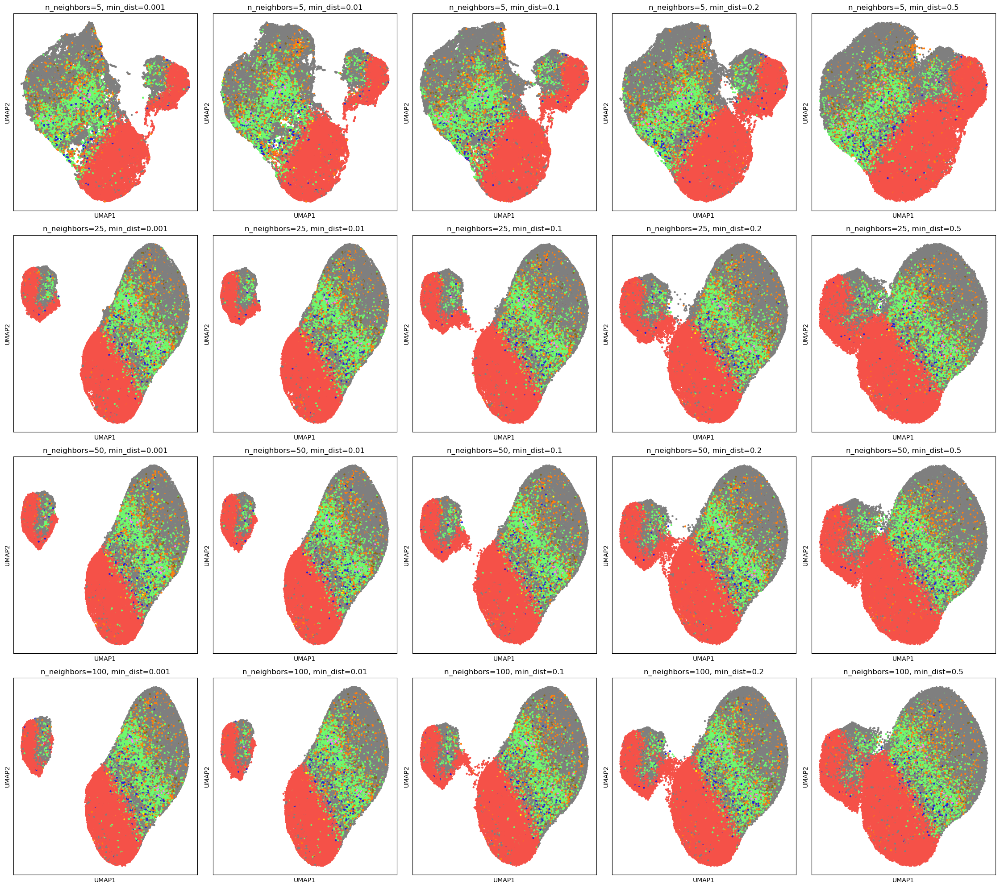

In [138]:
plot_umap_grid_results(
    grid_results=results,
    param_names=("n_neighbors", "min_dist"),
    color_series=ss_label,
    color_dict=color_dict,
    )

In [139]:
subsample = df.sample(10000)
ss_X = subsample.iloc[:,:-1]
ss_label = subsample.iloc[:,-1]

param_grid = {
    'n_neighbors': [3,5,10, 25],
    'min_dist': [0.0001, 0.001, 0.01, 0.1],
    'n_components': [2],
    'metric': ['euclidean']
}

grid = list(ParameterGrid(param_grid))

results = []
with tqdm(total=len(grid), desc="UMAP grid search") as pbar:
    for params in grid:
        reducer = umap.UMAP(**params)
        embedding = reducer.fit_transform(ss_X)
        results.append({
            'embedding': embedding,
            'params': params,
        })
        
        # Update progress bar with current params (brief version)
        brief_params = {k: params[k] for k in ['n_neighbors', 'min_dist']}
        pbar.set_postfix(brief_params)
        pbar.update(1)

UMAP grid search: 100%|██████████| 16/16 [01:48<00:00,  6.78s/it, n_neighbors=25, min_dist=0.1]  


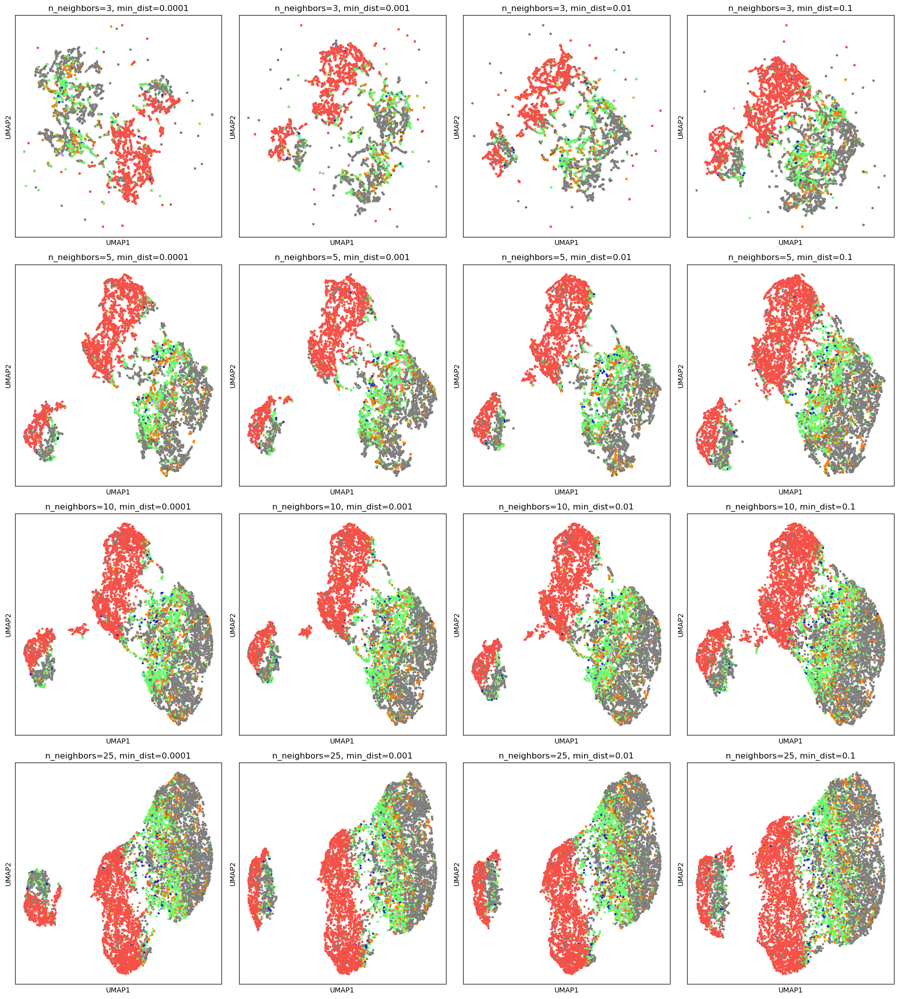

In [140]:
plot_umap_grid_results(
    grid_results=results,
    param_names=("n_neighbors", "min_dist"),
    color_series=ss_label,
    color_dict=color_dict,
    )

# 14.05.2025 UMAP

## raw data, standard scale (zscore)

### 991

In [122]:
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/5_filtering_done/20250302_1752_5_filtering_done_adata.h5ad")

In [123]:
# create data from adata
df_markers = pd.DataFrame(data=adata.X, columns=adata.var_names, index=adata.obs.CellID)
# append morphodata
columns = ['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity']
df_morpho = pd.DataFrame(data=adata.obs[columns].values, columns=columns, index=adata.obs["CellID"])
df = pd.merge(left=df_markers, right=df_morpho, left_index=True, right_index=True)

In [124]:
df_scaled = pd.DataFrame(
    data=StandardScaler().fit_transform(df), 
    columns=df.columns, index=df.index)

In [125]:
adata_pheno = ad.read_h5ad("../data/perSample/991/adata_checkpoints/6_phenotyped/20250302_1753_6_phenotyped_adata.h5ad")
subsample = match_cat_subsample_split(
    df=df_scaled, 
    metadata_df=adata_pheno.obs, 
    metadata_categorical="phenotype", 
    metadata_index="CellID", 
    subsample=150000,
    no_split=True)
subsample

,std_750_bg,std_647_bg,std_555_bg,std_488_bg,std_DAPI_bg,std_Vimentin,std_CD3e,std_panCK,std_CD8,std_DAPI_1,...,quantile75_Ki67,quantile75_DAPI_2,Area,MajorAxisLength,MinorAxisLength,Eccentricity,Orientation,Extent,Solidity,phenotype
CellID,,,,,,,,,,,,,,,,,,,,,
501844,1.072344,-0.075618,-0.137317,-0.219554,-0.649193,-0.474837,-0.349679,1.158288,-0.480018,-0.564924,...,-0.201126,-0.356954,-0.298801,-0.733708,0.237460,-1.509229,0.785873,-0.541389,0.986782,Cancer_cells
384381,1.385933,0.190112,0.154607,-0.005574,1.414082,-0.558079,-0.645927,-0.447268,-0.364532,1.511157,...,-0.201126,1.196640,-0.015491,0.224266,-0.198026,0.684957,-0.922924,-0.109816,1.057152,Unknown
543308,0.077577,-0.275106,-0.419335,-0.500219,-0.989160,-0.355492,-0.567266,0.956022,0.236539,-0.973611,...,6.810849,-1.036430,1.537595,1.503231,1.494886,0.294744,0.338526,1.974002,-1.751640,Cancer_cells
503016,-0.101950,-0.021121,-0.140913,-0.068318,-0.721990,-0.353065,0.216189,-0.443732,-0.381493,-0.607298,...,-0.201126,0.103993,-0.815927,-0.986790,-0.677499,-0.194548,0.104675,-1.007059,0.364861,CD4_Tcells
197346,0.659608,0.008546,0.033596,-0.061703,-0.357784,1.104811,1.132986,-0.520469,-0.139745,0.576845,...,-0.201126,2.865248,-1.106064,-1.417022,-0.854970,-0.872801,0.361567,-1.306765,0.463615,B_cells
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
663472,-0.950088,-0.325664,-0.468205,-0.538530,0.150729,-0.182202,-0.116054,-0.522580,-0.511028,0.301740,...,-0.201126,-0.262287,0.853213,0.369459,1.216734,-0.741683,-0.782786,0.636912,0.747219,Unknown
546227,0.825788,-0.094626,-0.111767,-0.292648,-1.065360,-0.113809,0.136788,-0.466503,-0.406297,-1.097923,...,-0.201126,-0.898411,1.010228,0.329640,1.564395,-1.425526,-0.523634,0.800226,0.855818,COL1A1_cells
165619,0.892169,-0.102056,-0.173391,-0.267365,2.237192,-0.122087,-0.183090,-0.468832,0.245168,1.932248,...,-0.201126,-0.518860,-0.822754,-1.047947,-0.606741,-0.452048,-1.437240,-1.044357,0.679001,Unknown


In [126]:
#remove Unknowns
subsample = subsample[subsample['phenotype'] != "Unknown"]
#split
data = subsample.iloc[:,:-1]
labels = subsample.iloc[:,-1]

In [127]:
params = {'n_neighbors': [5,10,25,50], 'min_dist': [0.001, 0.01, 0.1, 0.2, 0.5], 'n_components': [2], 'metric': ['euclidean']}
results = run_umap_grid_settings(grid_settings=params, data=data)

UMAP grid search: 100%|██████████| 20/20 [04:09<00:00, 12.48s/it, n_neighbors=50, min_dist=0.5] 


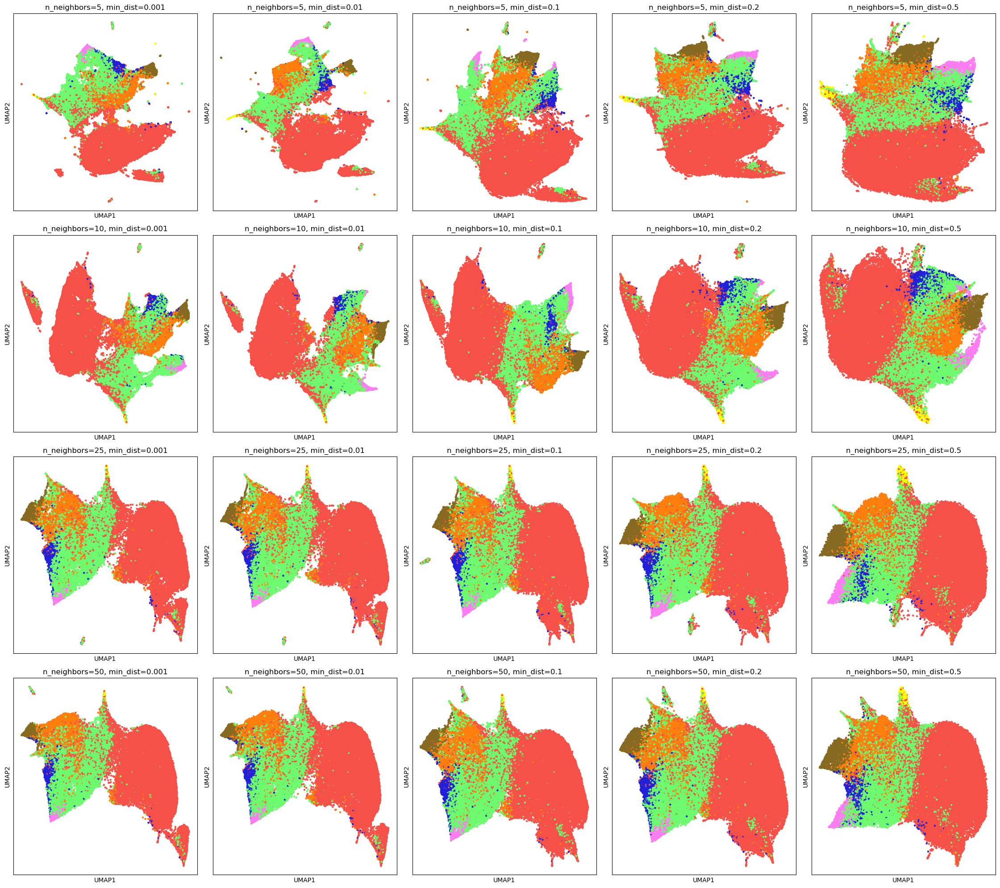

In [128]:
plot_umap_grid_results(
    grid_results=results,
    param_names=("n_neighbors", "min_dist"),
    color_series=labels,
    color_dict=color_dict,
    )

In [ ]:
# this fails

## same but min,max

In [75]:
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/5_filtering_done/20250302_1752_5_filtering_done_adata.h5ad")

In [76]:
# create data from adata
df_markers = pd.DataFrame(data=adata.X, columns=adata.var_names, index=adata.obs.CellID)
df_markers

,std_750_bg,std_647_bg,std_555_bg,std_488_bg,std_DAPI_bg,std_Vimentin,std_CD3e,std_panCK,std_CD8,std_DAPI_1,...,quantile75_Vimentin,quantile75_CD3e,quantile75_panCK,quantile75_CD8,quantile75_DAPI_1,quantile75_COL1A1,quantile75_CD20,quantile75_CD68,quantile75_Ki67,quantile75_DAPI_2
CellID,,,,,,,,,,,,,,,,,,,,,
1,41.461879,53.659788,49.309493,200.259604,293.016404,17.130015,39.752603,507.595592,142.687713,207.805129,...,26.00,210.00,586.00,778.50,512.5,1010.00,214.00,47.0,0.0,180.00
2,40.490387,57.285263,55.572827,272.513485,100.859416,19.037045,39.202903,160.053639,95.518951,66.822572,...,31.00,200.00,309.50,580.50,301.0,1649.00,327.00,74.0,0.0,150.50
3,37.306977,51.420912,48.657057,202.735215,521.368069,18.545898,180.109307,614.089391,119.210731,372.585199,...,24.00,243.00,1696.00,794.00,1236.0,1123.00,244.00,55.0,0.0,380.00
4,32.089896,46.208358,41.483179,162.604498,512.721100,52.330565,526.061306,12.027664,214.472596,365.062316,...,69.00,602.00,0.00,1144.00,963.5,877.00,337.00,51.0,0.0,298.00
5,40.127534,61.024925,62.499609,348.885138,558.572462,63.805350,224.495425,253.642134,186.853325,388.263525,...,46.00,345.00,623.00,956.00,1233.0,1070.00,291.00,75.0,0.0,360.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
685801,38.485352,66.591807,63.226838,430.517158,732.281149,27.139890,96.772639,263.924945,146.264609,475.066378,...,102.00,662.00,249.00,1310.25,956.0,2530.00,319.00,133.0,0.0,327.00
685802,47.780091,59.232044,54.975240,169.889542,634.667067,38.065066,116.151500,477.983507,219.382574,361.719553,...,126.25,507.00,1039.25,2215.00,1168.0,1045.00,251.00,84.0,0.0,310.00
685803,49.075153,63.727945,55.835855,159.275846,691.710118,121.683879,499.780392,21.016286,496.552850,457.859822,...,338.25,1858.50,23.00,2373.25,1152.0,1691.25,309.00,135.0,0.0,380.50


In [77]:
# append morphodata
columns = ['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity']
df_morpho = pd.DataFrame(data=adata.obs[columns].values, columns=columns, index=adata.obs["CellID"])
df = pd.merge(left=df_markers, right=df_morpho, left_index=True, right_index=True)
df 

,std_750_bg,std_647_bg,std_555_bg,std_488_bg,std_DAPI_bg,std_Vimentin,std_CD3e,std_panCK,std_CD8,std_DAPI_1,...,quantile75_CD68,quantile75_Ki67,quantile75_DAPI_2,Area,MajorAxisLength,MinorAxisLength,Eccentricity,Orientation,Extent,Solidity
CellID,,,,,,,,,,,,,,,,,,,,,
1,41.461879,53.659788,49.309493,200.259604,293.016404,17.130015,39.752603,507.595592,142.687713,207.805129,...,47.0,0.0,180.00,1519.0,98.696620,30.646839,0.950568,-1.524977,228.651804,0.676615
2,40.490387,57.285263,55.572827,272.513485,100.859416,19.037045,39.202903,160.053639,95.518951,66.822572,...,74.0,0.0,150.50,1567.0,50.422862,39.687556,0.616832,0.160002,148.710678,0.975109
3,37.306977,51.420912,48.657057,202.735215,521.368069,18.545898,180.109307,614.089391,119.210731,372.585199,...,55.0,0.0,380.00,1025.0,40.280587,34.195207,0.528513,-0.346644,131.438600,0.927602
4,32.089896,46.208358,41.483179,162.604498,512.721100,52.330565,526.061306,12.027664,214.472596,365.062316,...,51.0,0.0,298.00,1315.0,61.049935,28.208869,0.886848,-1.447088,151.254834,0.947406
5,40.127534,61.024925,62.499609,348.885138,558.572462,63.805350,224.495425,253.642134,186.853325,388.263525,...,75.0,0.0,360.00,3656.0,84.178897,57.384893,0.731630,0.251203,243.379726,0.926743
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
685801,38.485352,66.591807,63.226838,430.517158,732.281149,27.139890,96.772639,263.924945,146.264609,475.066378,...,133.0,0.0,327.00,1080.0,56.372404,25.352581,0.893163,1.002754,141.610173,0.961710
685802,47.780091,59.232044,54.975240,169.889542,634.667067,38.065066,116.151500,477.983507,219.382574,361.719553,...,84.0,0.0,310.00,1076.0,41.856049,34.076776,0.580666,1.330143,129.396970,0.951370
685803,49.075153,63.727945,55.835855,159.275846,691.710118,121.683879,499.780392,21.016286,496.552850,457.859822,...,135.0,0.0,380.50,768.0,33.256837,29.969709,0.433488,0.983058,105.254834,0.957606


In [79]:
df_scaled = pd.DataFrame(
    data=MinMaxScaler().fit_transform(df), 
    columns=df.columns, index=df.index)
df_scaled

,std_750_bg,std_647_bg,std_555_bg,std_488_bg,std_DAPI_bg,std_Vimentin,std_CD3e,std_panCK,std_CD8,std_DAPI_1,...,quantile75_CD68,quantile75_Ki67,quantile75_DAPI_2,Area,MajorAxisLength,MinorAxisLength,Eccentricity,Orientation,Extent,Solidity
CellID,,,,,,,,,,,,,,,,,,,,,
1,0.014926,0.004426,0.009404,0.019788,0.087230,0.004170,0.009130,0.072852,0.022857,0.047692,...,0.005593,0.0,0.039675,0.243202,0.635682,0.270999,0.969196,0.014584,0.481331,0.418507
2,0.014261,0.005008,0.011901,0.031389,0.026376,0.004634,0.009004,0.022972,0.015301,0.013018,...,0.008806,0.0,0.031547,0.253644,0.228982,0.400706,0.620663,0.550931,0.232230,0.967454
3,0.012084,0.004067,0.009144,0.020186,0.159546,0.004515,0.041366,0.088137,0.019097,0.088219,...,0.006545,0.0,0.094779,0.135741,0.143535,0.321907,0.528427,0.389660,0.178409,0.880086
4,0.008516,0.003230,0.006284,0.013742,0.156807,0.012739,0.120820,0.001726,0.034357,0.086368,...,0.006069,0.0,0.072186,0.198825,0.318514,0.236022,0.902650,0.039377,0.240158,0.916508
5,0.014013,0.005609,0.014663,0.043652,0.171328,0.015532,0.051560,0.036404,0.029932,0.092075,...,0.008925,0.0,0.089268,0.708070,0.513372,0.654609,0.740551,0.579961,0.527224,0.878506
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
685801,0.012890,0.006502,0.014952,0.056758,0.226339,0.006607,0.022226,0.037880,0.023430,0.113424,...,0.015827,0.0,0.080176,0.147705,0.279106,0.195043,0.909245,0.819187,0.210104,0.942813
685802,0.019247,0.005321,0.011663,0.014912,0.195426,0.009266,0.026677,0.068602,0.035143,0.085546,...,0.009996,0.0,0.075492,0.146835,0.156808,0.320208,0.582892,0.923399,0.172047,0.923798
685803,0.020132,0.006043,0.012006,0.013208,0.213491,0.029621,0.114785,0.003016,0.079543,0.109192,...,0.016065,0.0,0.094917,0.079835,0.084360,0.261284,0.429189,0.812918,0.096819,0.935266


In [80]:
adata_pheno = ad.read_h5ad("../data/perSample/991/adata_checkpoints/6_phenotyped/20250302_1753_6_phenotyped_adata.h5ad")
data, labels = match_cat_subsample_split(df=df_scaled, metadata_df=adata_pheno.obs, metadata_categorical="phenotype", metadata_index="CellID", subsample=10000)
print(data.shape)
print(labels.shape)
print(labels.value_counts())

(10000, 83)
(10000,)
phenotype
Cancer_cells      3565
Unknown           3556
CD4_Tcells        1784
COL1A1_cells       736
CD8_Tcells         168
Vimentin_cells     112
B_cells             60
Macrophages         19
Name: count, dtype: int64


In [81]:
params = {'n_neighbors': [3,5,10,25,50], 'min_dist': [0.001, 0.01, 0.1, 0.2, 0.5], 'n_components': [2], 'metric': ['euclidean']}
results = run_umap_grid_settings(grid_settings=params, data=data)

UMAP grid search:   0%|          | 0/25 [00:00<?, ?it/s]/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:329: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
UMAP grid search:   4%|▍         | 1/25 [00:02<00:55,  2.32s/it, n_neighbors=3, min_dist=0.001]/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:329: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
UMAP grid search:   8%|▊         | 2/25 [00:03<00:43,  1.90s/it, n_neighbors=5, min_dist=0.001]/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:329: UserWarning: Graph is not fully connected, spectral embedding

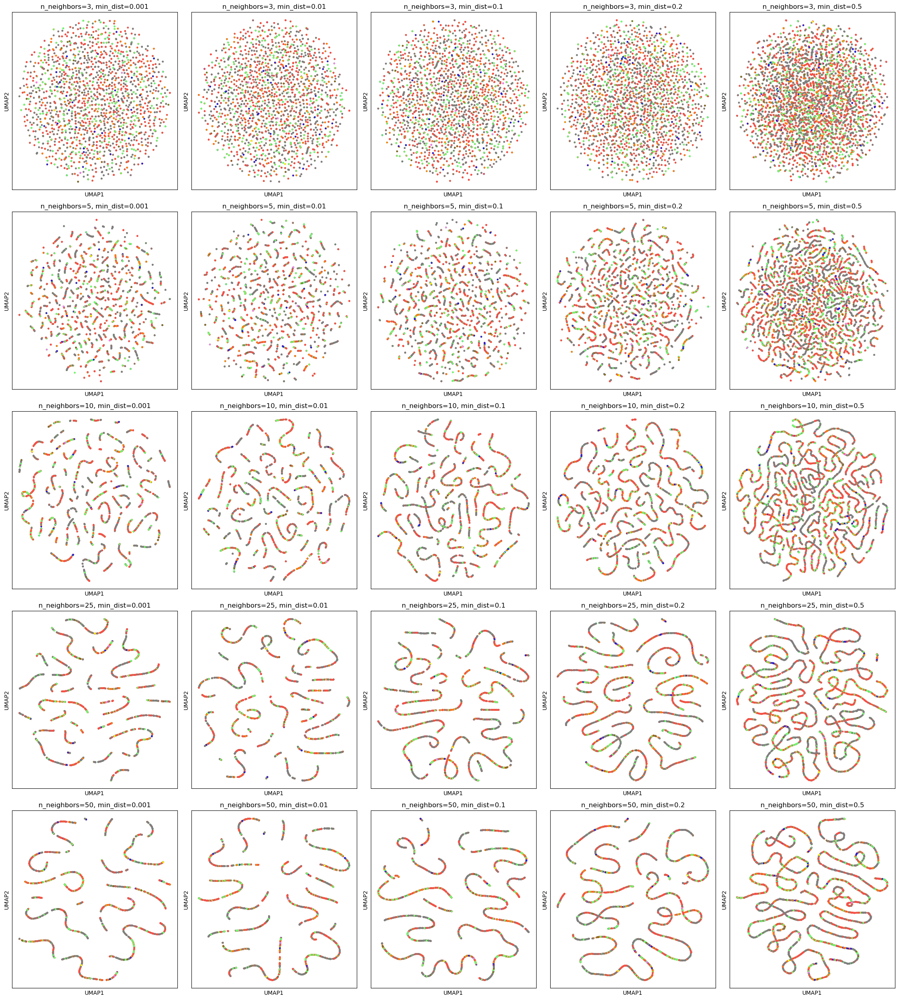

In [82]:
plot_umap_grid_results(
    grid_results=results,
    param_names=("n_neighbors", "min_dist"),
    color_series=labels,
    color_dict=color_dict,
    )

In [ ]:
## scaling does not help

In [ ]:
# posibly feature selection helps, too many features, too noisy

## Let's try phenotyped data only, without morpho

In [83]:
adata_991 = ad.read_h5ad("../data/perSample/991/adata_checkpoints/7_adata_pheno/20250302_1823_7_adata_pheno_adata.h5ad")

In [84]:
# create data from adata
df_markers = pd.DataFrame(data=adata_991.X, columns=adata_991.var_names, index=adata_991.obs.CellID)
df_markers

,mean_Vimentin,mean_CD3e,mean_panCK,mean_CD8,mean_COL1A1,mean_CD20,mean_CD68,mean_Ki67
CellID,,,,,,,,
1,0.217430,0.445292,0.706378,0.443221,0.457555,0.392043,0.299051,0.000000
2,0.232569,0.441189,0.635352,0.423866,0.542440,0.425889,0.338904,0.000000
3,0.215473,0.466213,0.794898,0.445378,0.473647,0.402801,0.311815,0.000000
4,0.309152,0.556337,0.227288,0.466315,0.443738,0.431272,0.305019,0.000000
5,0.290441,0.483283,0.701336,0.456075,0.467879,0.413881,0.338755,0.000000
...,...,...,...,...,...,...,...,...
685801,0.349347,0.580561,0.616782,0.481668,0.648872,0.418773,0.394006,0.005254
685802,0.365076,0.540715,0.739696,0.554223,0.465899,0.404583,0.345634,0.000000
685803,0.440463,0.730069,0.339847,0.553126,0.552363,0.418617,0.399508,0.000000


In [94]:
data, labels = match_cat_subsample_split(
    df=df_markers, 
    metadata_df=adata_991.obs, 
    metadata_categorical="phenotype", 
    metadata_index="CellID", 
    subsample=10000)

In [95]:
data

,mean_Vimentin,mean_CD3e,mean_panCK,mean_CD8,mean_COL1A1,mean_CD20,mean_CD68,mean_Ki67
CellID,,,,,,,,
355289,0.247566,0.343304,0.109160,0.367207,0.406352,0.324153,0.213657,0.000000
544116,0.350969,0.467295,0.762503,0.461025,0.436068,0.390151,0.332528,0.000000
419181,0.206613,0.346645,0.074587,0.383955,0.441697,0.258823,0.306727,0.021115
225427,0.300670,0.415021,0.565164,0.454203,0.460464,0.439397,0.314553,0.556333
43278,0.238856,0.615982,0.100865,0.426069,0.479885,0.377419,0.375657,0.000000
...,...,...,...,...,...,...,...,...
564231,0.388011,0.719419,0.823256,0.496181,0.469298,0.412136,0.327499,0.706060
223191,0.369574,0.404759,0.213410,0.415867,0.457222,0.365282,0.279150,0.000000
53806,0.180706,0.401295,0.152048,0.421966,0.433981,0.362582,0.324142,0.677711


In [96]:
data.mean(axis=0)

mean_Vimentin    0.308026
mean_CD3e        0.474165
mean_panCK       0.374222
mean_CD8         0.433568
mean_COL1A1      0.451848
mean_CD20        0.380814
mean_CD68        0.323272
mean_Ki67        0.089790
dtype: float64

In [97]:
params = {'n_neighbors': [5,10,25], 'min_dist': [0.01, 0.1, 0.2], 'n_components': [2], 'metric': ['euclidean']}
results = run_umap_grid_settings(grid_settings=params, data=data)

UMAP grid search: 100%|██████████| 9/9 [00:16<00:00,  1.87s/it, n_neighbors=25, min_dist=0.2] 


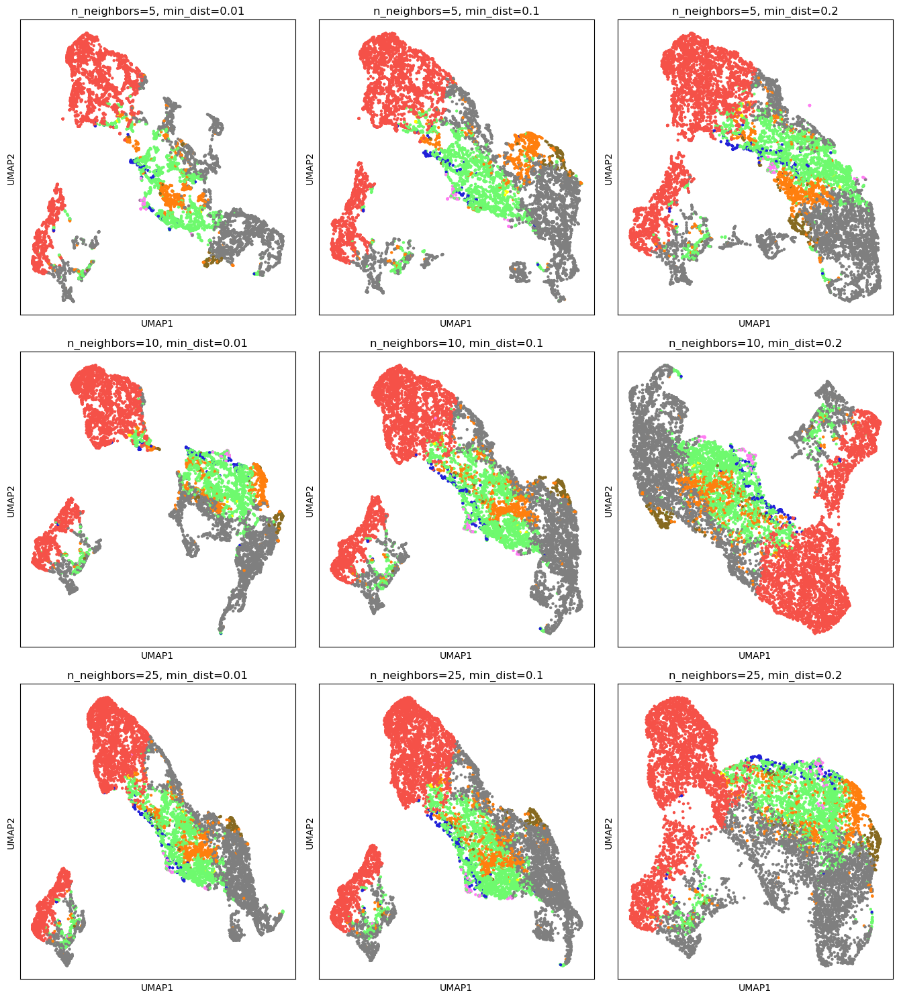

In [98]:
plot_umap_grid_results(
    grid_results=results,
    param_names=("n_neighbors", "min_dist"),
    color_series=labels,
    color_dict=color_dict,
    )

# Tests

## Test 1: rawdata, all metrics, + morpho metrics, standardscale

In [135]:
# load adata
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/5_filtering_done/20250302_1752_5_filtering_done_adata.h5ad")
# create data from adata
df_markers = pd.DataFrame(data=adata.X, columns=adata.var_names, index=adata.obs.CellID)
# append morphodata
columns = ['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity']
df_morpho = pd.DataFrame(data=adata.obs[columns].values, columns=columns, index=adata.obs["CellID"])
df = pd.merge(left=df_markers, right=df_morpho, left_index=True, right_index=True)
#scale
scaler = StandardScaler() 
df_scaled = pd.DataFrame(data=scaler.fit_transform(df), columns=df.columns, index=df.index)
#add phenotype data
adata_pheno = ad.read_h5ad("../data/perSample/991/adata_checkpoints/6_phenotyped/20250302_1753_6_phenotyped_adata.h5ad")
df_pheno = pd.merge(left=df_scaled, right=adata_pheno.obs[["CellID","phenotype"]], left_index=True, right_on="CellID")
df_pheno.set_index("CellID", inplace=True)
#subsample
df_subsample = df_pheno.sample(100000)
#remove Unknown
df_subsample = df_subsample[df_subsample['phenotype'] != "Unknown"]
#split
data = df_subsample.iloc[:,:-1]
labels = df_subsample.iloc[:,-1]

In [136]:
params = {'n_neighbors': [5,10,25,50], 'min_dist': [0.001, 0.01, 0.1, 0.2, 0.5], 'n_components': [2], 'metric': ['euclidean']}
results = run_umap_grid_settings(params, data)

UMAP grid search: 100%|██████████| 20/20 [02:42<00:00,  8.12s/it, n_neighbors=50, min_dist=0.5] 


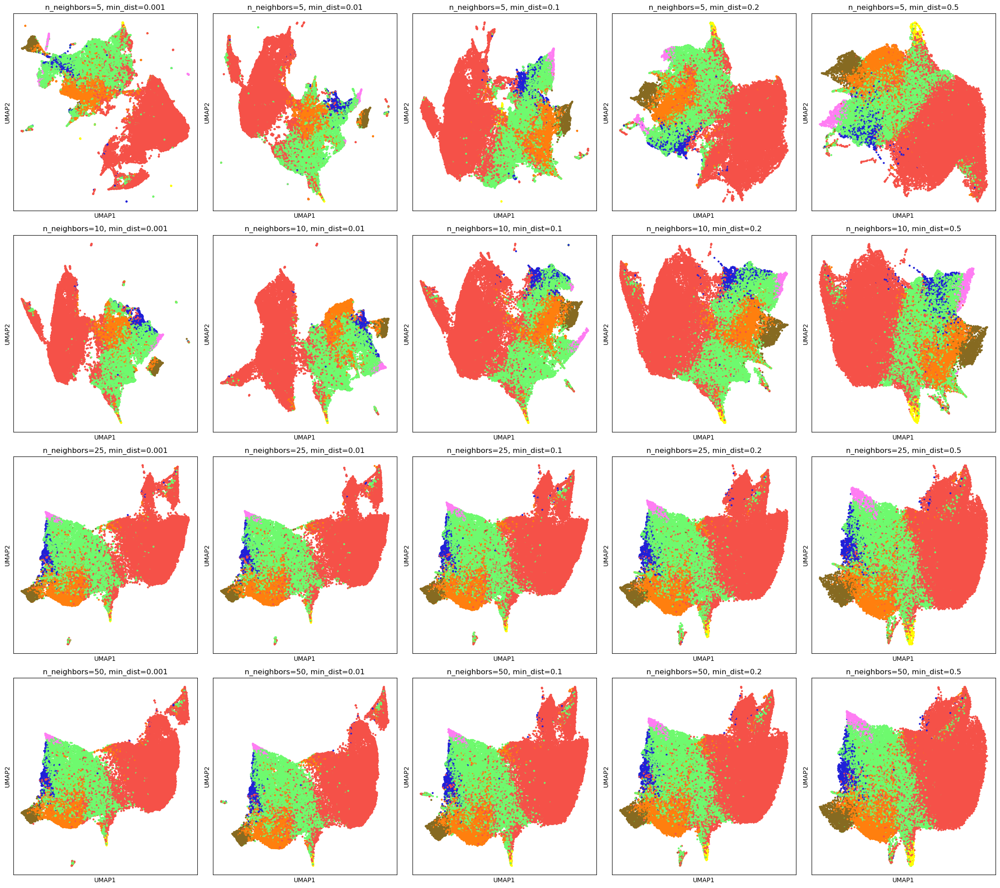

In [137]:
plot_umap_grid_results(grid_results=results,param_names=("n_neighbors", "min_dist"), color_series=labels,color_dict=color_dict)

## Test 2: rawdata, all metrics + morpho metrics, minmaxscale

In [138]:
# load adata
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/5_filtering_done/20250302_1752_5_filtering_done_adata.h5ad")
# create data from adata
df_markers = pd.DataFrame(data=adata.X, columns=adata.var_names, index=adata.obs.CellID)
# append morphodata
columns = ['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity']
df_morpho = pd.DataFrame(data=adata.obs[columns].values, columns=columns, index=adata.obs["CellID"])
df = pd.merge(left=df_markers, right=df_morpho, left_index=True, right_index=True)
#scale
scaler = MinMaxScaler() 
df_scaled = pd.DataFrame(data=scaler.fit_transform(df), columns=df.columns, index=df.index)
#add phenotype data
adata_pheno = ad.read_h5ad("../data/perSample/991/adata_checkpoints/6_phenotyped/20250302_1753_6_phenotyped_adata.h5ad")
df_pheno = pd.merge(left=df_scaled, right=adata_pheno.obs[["CellID","phenotype"]], left_index=True, right_on="CellID")
df_pheno.set_index("CellID", inplace=True)
#subsample
df_subsample = df_pheno.sample(100000)
#remove Unknown
df_subsample = df_subsample[df_subsample['phenotype'] != "Unknown"]
#split
data = df_subsample.iloc[:,:-1]
labels = df_subsample.iloc[:,-1]

In [139]:
params = {'n_neighbors': [5,10,25,50], 'min_dist': [0.001, 0.01, 0.1, 0.2, 0.5], 'n_components': [2], 'metric': ['euclidean']}
results_minmax = run_umap_grid_settings(params, data)

UMAP grid search: 100%|██████████| 20/20 [02:35<00:00,  7.76s/it, n_neighbors=50, min_dist=0.5] 


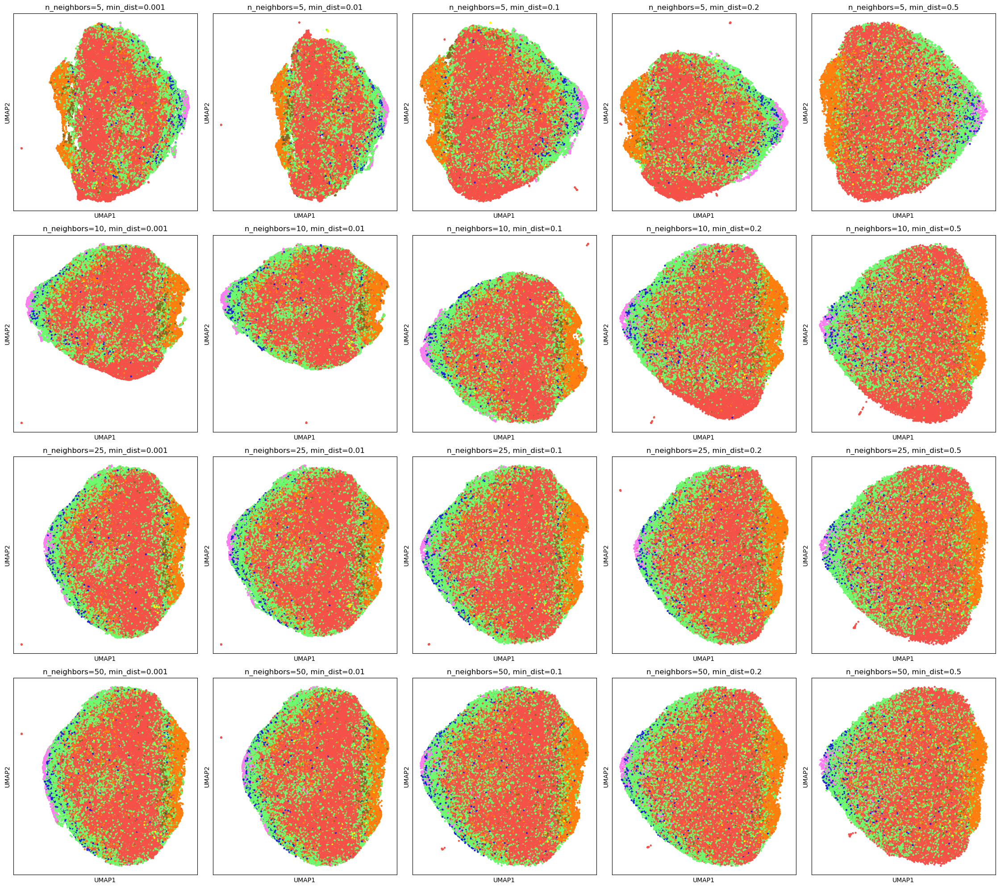

In [140]:
plot_umap_grid_results(grid_results=results_minmax, param_names=("n_neighbors", "min_dist"), color_series=labels, color_dict=color_dict)

## Test 3: rawdata, all metrics + morpho metrics, PCA

In [212]:
# load adata
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/5_filtering_done/20250302_1752_5_filtering_done_adata.h5ad")
# create data from adata
df_markers = pd.DataFrame(data=adata.X, columns=adata.var_names, index=adata.obs.CellID)
# append morphodata
columns = ['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity']
df_morpho = pd.DataFrame(data=adata.obs[columns].values, columns=columns, index=adata.obs["CellID"])
df = pd.merge(left=df_markers, right=df_morpho, left_index=True, right_index=True)
#scale
scaler = StandardScaler() 
df_scaled = pd.DataFrame(data=scaler.fit_transform(df), columns=df.columns, index=df.index)
#add phenotype data
adata_pheno = ad.read_h5ad("../data/perSample/991/adata_checkpoints/6_phenotyped/20250302_1753_6_phenotyped_adata.h5ad")
df_pheno = pd.merge(left=df_scaled, right=adata_pheno.obs[["CellID","phenotype"]], left_index=True, right_on="CellID")
df_pheno.set_index("CellID", inplace=True)
#subsample
df_subsample = df_pheno.sample(100000)
#remove Unknown
df_subsample = df_subsample[df_subsample['phenotype'] != "Unknown"]
#split
data = df_subsample.iloc[:,:-1]
labels = df_subsample.iloc[:,-1]

In [228]:
from sklearn.decomposition import PCA
pca_result = PCA().fit_transform(data)

In [260]:
params = {'n_neighbors': [5,10,25,50], 'min_dist': [0.001, 0.01, 0.1, 0.2, 0.5], 'n_components': [2], 'metric': ['euclidean']}
grid_df = run_umap_grid_search_df(X_pca=pca_result, param_grid=params, n_pcs_list=[10,20,30])

/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/Users/jnimoca/Jose_BI/4_Projects/P26_BCCN/P26E10_E11_ImageAnalysis/.pixi/envs/default/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/Users/jnimoca/Jose_BI/4_Project

In [268]:
grid_df.to_csv("../data/UMAP_grid_search.csv")

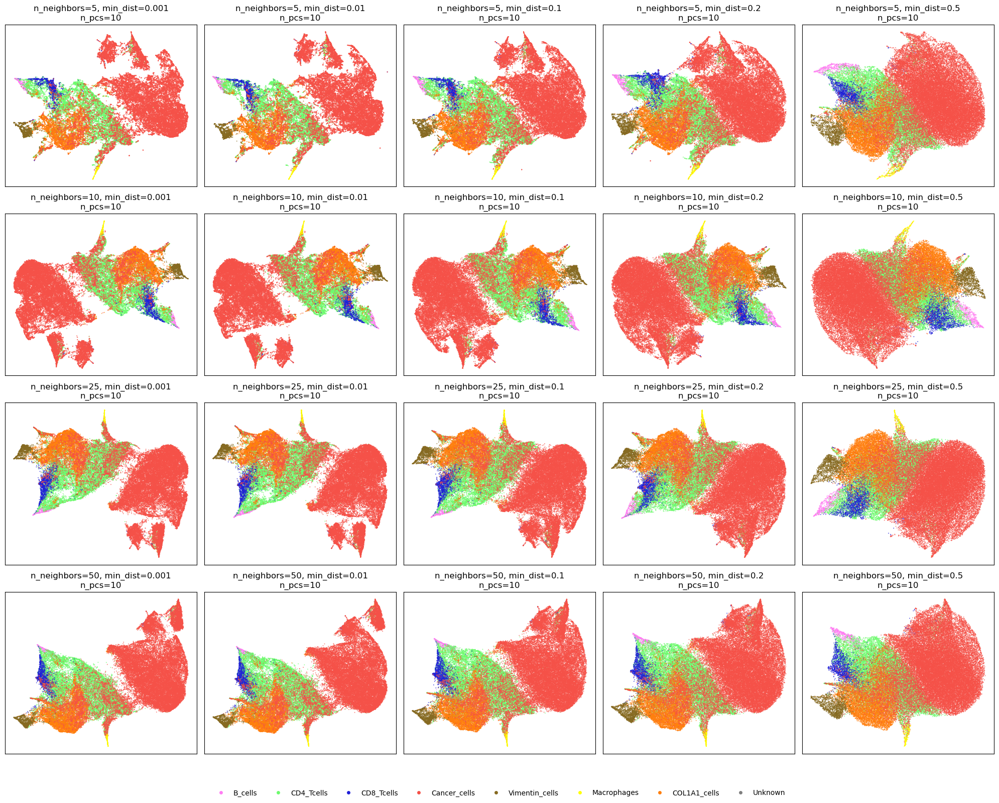

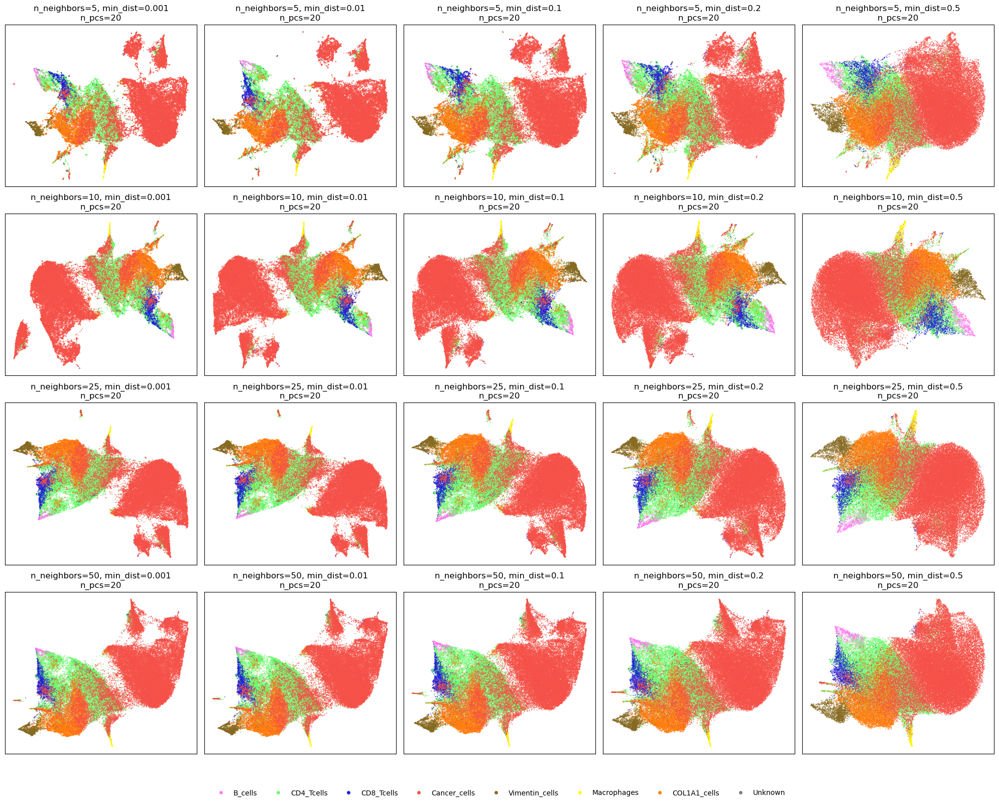

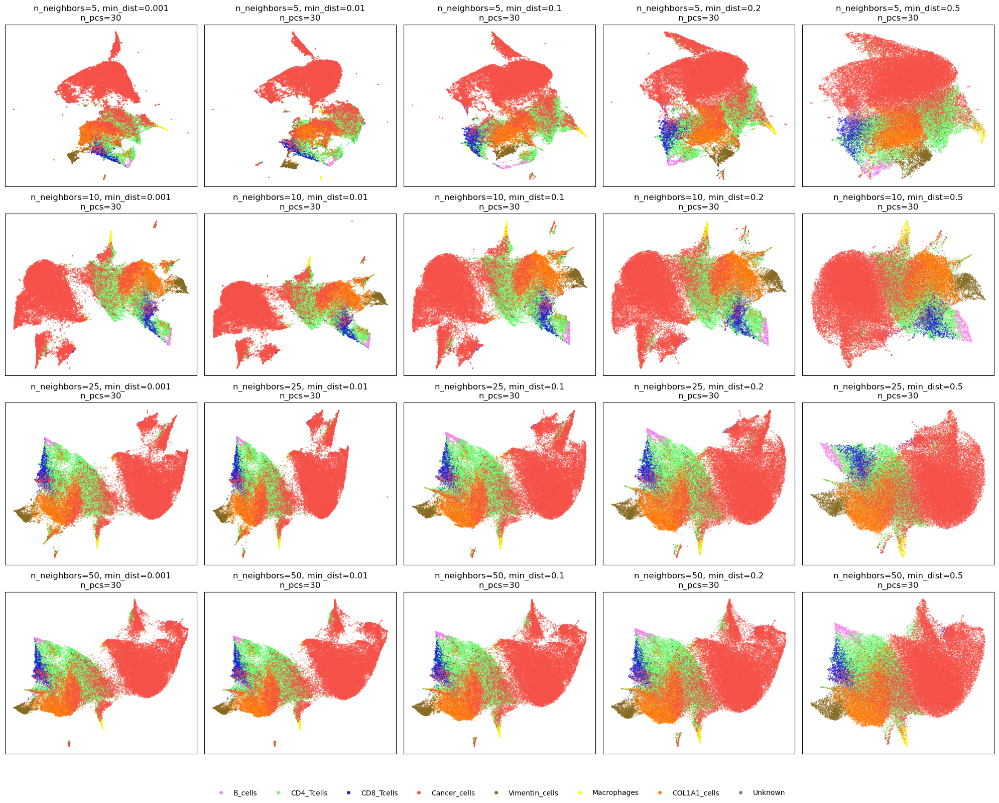

In [263]:
plot_umap_grid_from_df(
    df=grid_df,
    labels=labels.reset_index(drop=True),
    color_map=color_dict,
    grid_params=["n_neighbors", "min_dist","n_pcs"],
    point_size=2,
    ncols=5
)

In [272]:
from sklearn.decomposition import PCA
pca = PCA().fit(data)

In [285]:
data

,std_750_bg,std_647_bg,std_555_bg,std_488_bg,std_DAPI_bg,std_Vimentin,std_CD3e,std_panCK,std_CD8,std_DAPI_1,...,quantile75_CD68,quantile75_Ki67,quantile75_DAPI_2,Area,MajorAxisLength,MinorAxisLength,Eccentricity,Orientation,Extent,Solidity
CellID,,,,,,,,,,,,,,,,,,,,,
674392,0.402824,-0.141050,-0.148894,-0.248664,0.362346,0.866360,1.166726,-0.509851,-0.159680,-0.028064,...,0.022198,-0.201126,-0.847981,-1.300627,-1.810678,-0.883423,-2.971346,0.582137,-1.591022,0.582561
565797,0.026365,-0.097670,-0.096605,-0.010354,-0.766024,-0.337786,-0.370297,4.024927,0.349472,-0.888465,...,0.394576,-0.201126,-1.153214,-0.631605,-0.994147,-0.166527,-1.314557,-0.111402,-0.777424,0.739186
242202,-1.448838,-0.398632,-0.589662,-0.440710,-0.943367,0.063784,0.085851,2.604599,0.383696,-0.789610,...,-0.831343,-0.201126,-1.078897,-0.293681,-0.376833,0.161409,-0.454214,-0.463275,-0.098892,-0.427315
43680,-0.597133,-0.430898,-0.548885,-0.594093,0.376541,-0.459997,0.628787,-0.522054,-0.408909,0.654173,...,0.976155,1.061351,0.113725,-1.162385,-1.068926,-1.443286,0.780323,1.392577,-1.354987,0.304274
572454,0.026169,-0.180352,-0.230493,-0.348624,-0.664281,-0.531213,-0.663653,1.454777,-0.450254,-0.533570,...,-0.345996,-0.201126,-0.318025,0.237099,0.014609,0.679904,-0.560149,1.264064,0.346805,0.035449
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
533808,1.241727,0.303347,1.186468,0.950105,0.167082,-0.270151,1.070123,-0.455296,-0.370752,0.288678,...,1.976137,-0.201126,0.771967,-1.119718,-1.567659,-0.677701,-2.164754,0.623094,-1.329939,-0.387240
537411,-0.613801,-0.331884,-0.367637,-0.528287,-1.235332,-0.040434,-0.624320,-0.449782,-0.317903,-1.194979,...,0.432232,-0.201126,-1.209837,-0.162266,-0.498623,0.298865,-0.962988,0.026341,-0.286705,0.593626
619469,-0.447513,-0.056966,-0.189974,0.271020,0.489202,0.123604,0.849058,-0.522346,2.455652,0.032559,...,-0.680718,-0.201126,-0.848866,1.213324,0.439836,1.724946,-1.464321,-1.348793,0.867097,1.098637


In [286]:
import pandas as pd
loadings = pd.DataFrame(
    pca.components_.T,
    columns=[f'PC{i+1}' for i in range(pca.n_components_)],
    index=data.columns
)

In [287]:
loadings

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC73,PC74,PC75,PC76,PC77,PC78,PC79,PC80,PC81,PC82
std_750_bg,0.005247,-0.004100,0.000355,-0.064839,0.022011,-0.054481,-0.025370,0.027149,-0.030480,-0.094326,...,-0.000370,0.000279,-0.000432,-0.012891,0.000610,0.000289,-0.000879,0.004473,0.000339,0.008460
std_647_bg,0.022092,-0.018197,-0.020294,-0.167145,0.023743,-0.152745,-0.047816,0.083295,-0.068632,-0.157472,...,0.008122,0.001788,0.004455,0.039325,-0.013827,0.046441,-0.012289,0.047669,-0.000180,-0.000072
std_555_bg,0.022956,-0.031550,-0.029074,-0.148064,0.021273,-0.126472,-0.007148,0.053943,-0.035441,-0.049872,...,0.002692,-0.001274,-0.001179,0.041260,0.015432,-0.033832,0.014270,-0.071019,-0.004546,-0.105365
std_488_bg,0.022467,-0.034716,-0.029283,-0.152398,0.021722,-0.128246,-0.000779,0.058668,-0.028159,-0.048654,...,0.006194,-0.011642,-0.002309,-0.022193,0.003483,-0.043705,0.019492,-0.083033,-0.003356,0.076038
std_DAPI_bg,0.141103,0.084999,-0.044744,-0.061497,0.013253,0.056365,-0.060326,0.059094,0.058347,-0.056841,...,-0.002200,0.004672,-0.000090,-0.003290,-0.002210,0.016808,0.080213,0.007188,0.141095,-0.004401
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MinorAxisLength,-0.077267,-0.014926,0.042839,-0.069033,0.098818,0.062826,0.155484,0.128237,0.214271,-0.231165,...,0.001590,-0.001874,-0.001478,0.000825,0.001542,0.003512,0.000491,0.000171,-0.000049,0.000245
Eccentricity,0.014861,0.029183,-0.001796,-0.020682,0.029944,0.042601,0.014339,-0.030970,0.094823,0.045564,...,0.000155,-0.000307,-0.000269,0.000344,-0.000315,0.000310,-0.000141,0.000135,-0.000122,-0.000017
Orientation,-0.000392,0.001750,0.004632,0.002341,-0.001098,0.002744,-0.004563,0.003827,-0.001231,0.005178,...,-0.000018,-0.000022,0.000067,-0.000047,-0.000038,0.000100,-0.000066,0.000146,-0.000002,-0.000053
Extent,-0.071118,0.009968,0.045233,-0.095834,0.134140,0.105006,0.184472,0.122630,0.315737,-0.232776,...,-0.001110,0.000728,0.000185,0.000199,-0.005925,-0.003684,-0.002881,-0.001130,0.000501,-0.000620


In [288]:
top_features_pc1 = loadings['PC1'].abs().sort_values(ascending=False)

In [290]:
top_features_pc2 = loadings['PC2'].abs().sort_values(ascending=False)

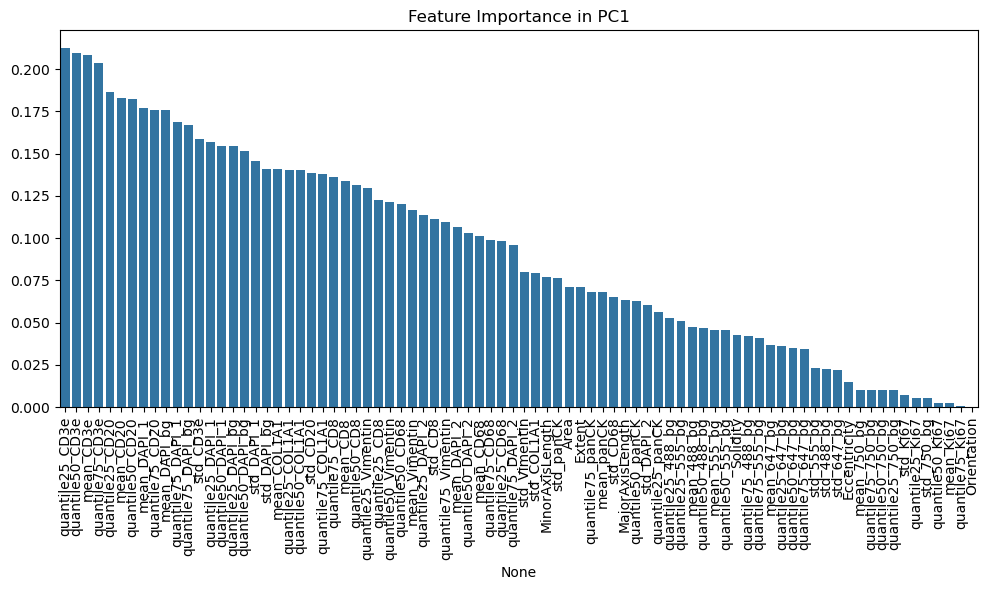

In [289]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
sns.barplot(x=top_features_pc1.index, y=top_features_pc1.values)
plt.title("Feature Importance in PC1")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

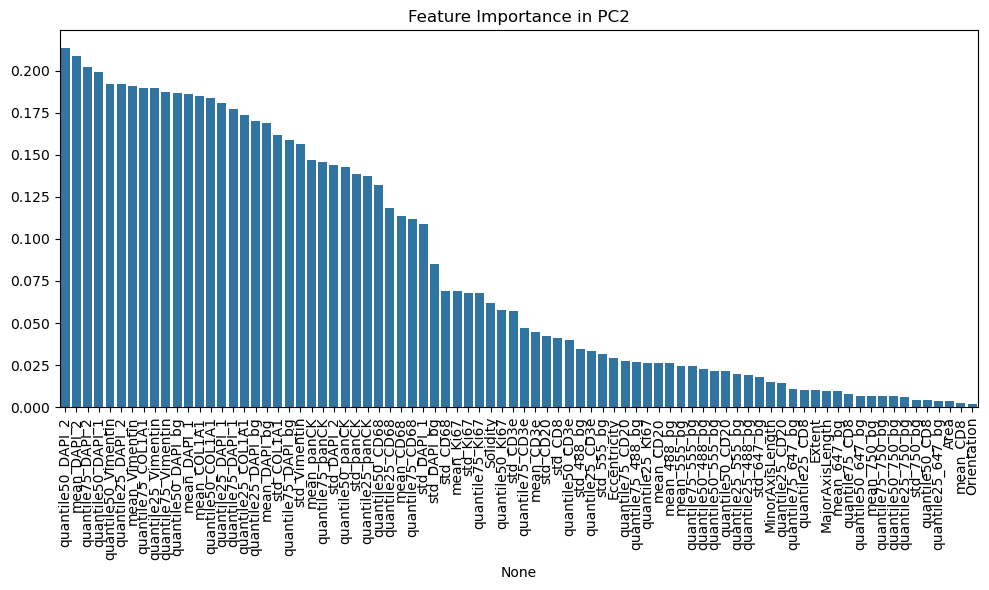

In [291]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
sns.barplot(x=top_features_pc2.index, y=top_features_pc2.values)
plt.title("Feature Importance in PC2")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

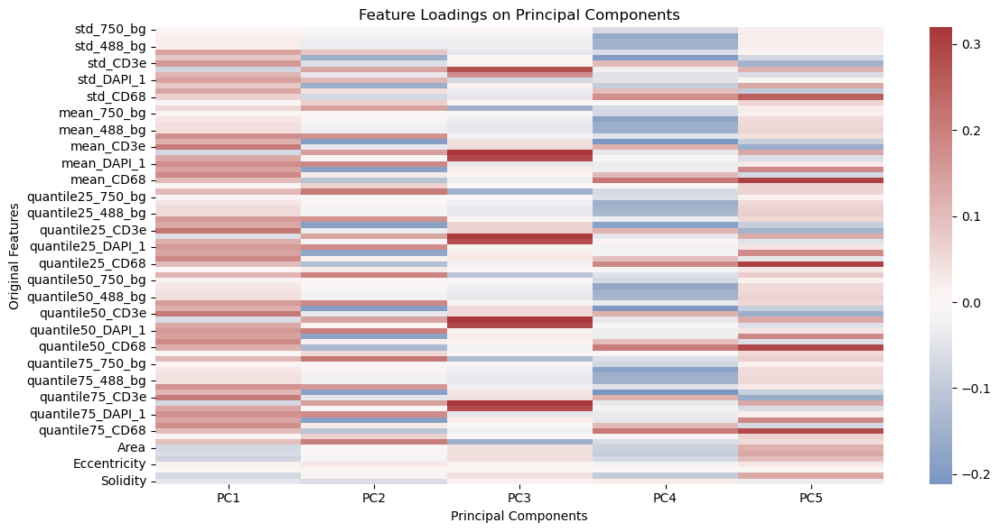

In [295]:
plt.figure(figsize=(12, 6))
sns.heatmap(loadings.iloc[:,:5], cmap='vlag', center=0, annot=False)
plt.title("Feature Loadings on Principal Components")
plt.xlabel("Principal Components")
plt.ylabel("Original Features")
plt.tight_layout()
plt.show()

<Figure size 1200x600 with 0 Axes>

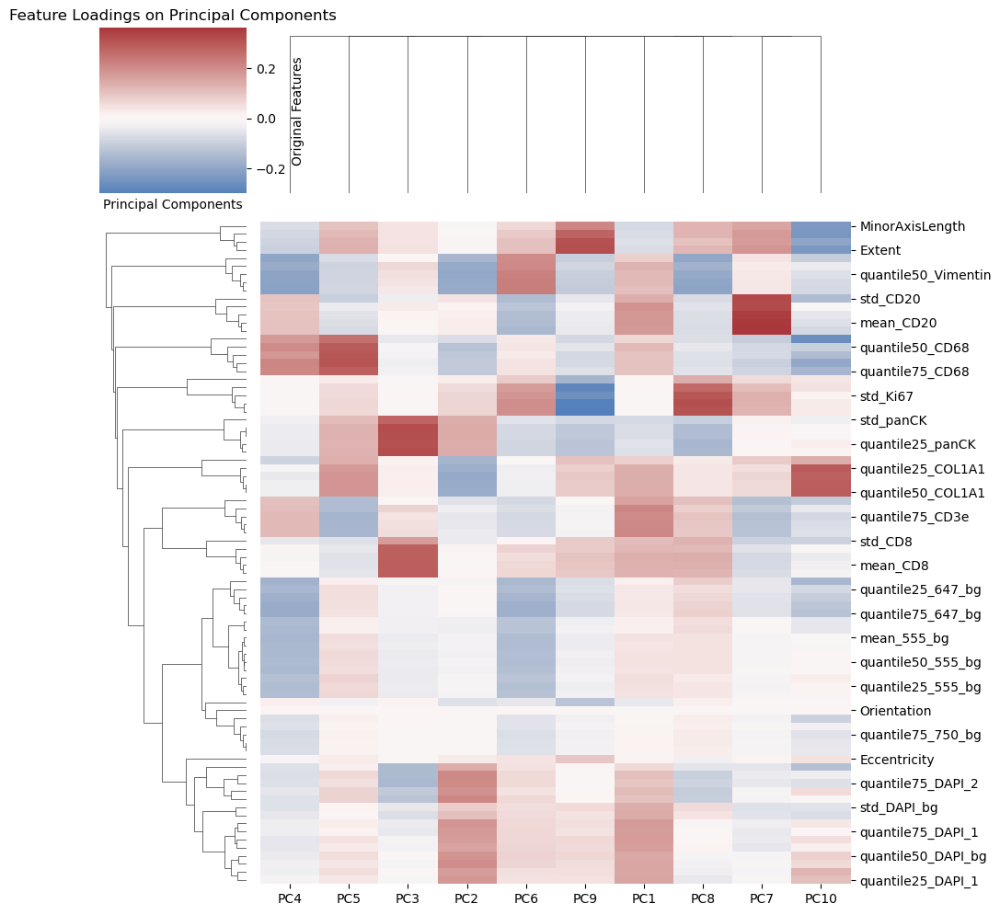

In [298]:
plt.figure(figsize=(12, 6))
sns.clustermap(loadings.iloc[:,:10], cmap='vlag', center=0, annot=False)
plt.title("Feature Loadings on Principal Components")
plt.xlabel("Principal Components")
plt.ylabel("Original Features")
plt.tight_layout()
plt.show()

In [271]:
pca_result.shape

(64297, 82)

In [ ]:
# We agree that PCs might not be good idea because data is not linear

## Test 4: rawdata, all metrics, standardscale

In [336]:
# load adata
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/5_filtering_done/20250302_1752_5_filtering_done_adata.h5ad")
# create data from adata
df_markers = pd.DataFrame(data=adata.X, columns=adata.var_names, index=adata.obs.CellID)
# append morphodata
# columns = ['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity']
# df_morpho = pd.DataFrame(data=adata.obs[columns].values, columns=columns, index=adata.obs["CellID"])
# df = pd.merge(left=df_markers, right=df_morpho, left_index=True, right_index=True)
#scale
scaler = StandardScaler() 
df_scaled = pd.DataFrame(data=scaler.fit_transform(df_markers), columns=df_markers.columns, index=df_markers.index)
#add phenotype data
adata_pheno = ad.read_h5ad("../data/perSample/991/adata_checkpoints/6_phenotyped/20250302_1753_6_phenotyped_adata.h5ad")
df_pheno = pd.merge(left=df_scaled, right=adata_pheno.obs[["CellID","phenotype"]], left_index=True, right_on="CellID")
df_pheno.set_index("CellID", inplace=True)
#subsample
df_subsample = df_pheno.sample(100000)
#remove Unknown
df_subsample = df_subsample[df_subsample['phenotype'] != "Unknown"]
#split
data = df_subsample.iloc[:,:-1]
labels = df_subsample.iloc[:,-1]

In [337]:
params = {'n_neighbors': [5,10,25,50], 'min_dist': [0.001, 0.01, 0.1, 0.2, 0.5], 'n_components': [2], 'metric': ['euclidean']}
results = run_umap_grid_settings(params, data)

UMAP grid search: 100%|██████████| 20/20 [10:07<00:00, 30.38s/it, n_neighbors=50, min_dist=0.5] 


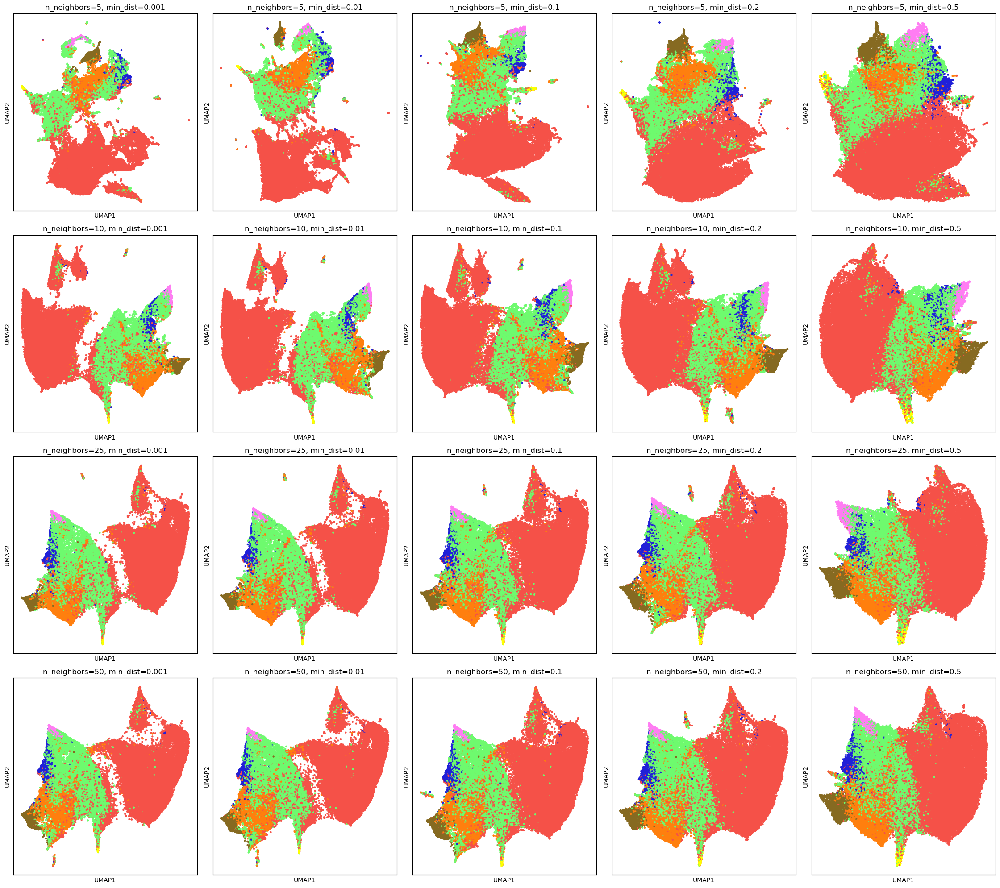

In [340]:
plot_umap_grid_results(grid_results=results, param_names=("n_neighbors", "min_dist"), color_series=labels, color_dict=color_dict)

## Test 5: rawdata, all metrics, minmaxscale

In [9]:
# load adata
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/5_filtering_done/20250302_1752_5_filtering_done_adata.h5ad")
# create data from adata
df_markers = pd.DataFrame(data=adata.X, columns=adata.var_names, index=adata.obs.CellID)
# remove non_median
# List of substrings to match
# keep_strings = ['quantile50']
# df_markers = df_markers[[col for col in df_markers.columns if any(s in col for s in keep_strings)]]
# remove_strings = ['DAPI', "_bg"]
# df_markers = df_markers[[col for col in df_markers.columns if not any(s in col for s in remove_strings)]]
# append morphodata
columns = ['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity']
df_morpho = pd.DataFrame(data=adata.obs[columns].values, columns=columns, index=adata.obs["CellID"])
df = pd.merge(left=df_markers, right=df_morpho, left_index=True, right_index=True)
#scale
scaler = MinMaxScaler() 
df_scaled = pd.DataFrame(data=scaler.fit_transform(df), columns=df.columns, index=df.index)
#add phenotype data
adata_pheno = ad.read_h5ad("../data/perSample/991/adata_checkpoints/6_phenotyped/20250302_1753_6_phenotyped_adata.h5ad")
df_pheno = pd.merge(left=df_scaled, right=adata_pheno.obs[["CellID","phenotype"]], left_index=True, right_on="CellID")
df_pheno.set_index("CellID", inplace=True)
#subsample
df_subsample = df_pheno.sample(100000)
#remove Unknown
df_subsample = df_subsample[df_subsample['phenotype'] != "Unknown"]
#split
data = df_subsample.iloc[:,:-1]
labels = df_subsample.iloc[:,-1]

In [26]:
params = {'n_neighbors': [10,25], 'min_dist': [0.01, 0.1, 0.2], 'n_components': [2], 'metric': ['euclidean']}
results = run_umap_grid_search_df(data, params)

UMAP Grid Search: 100%|██████████| 6/6 [00:41<00:00,  6.94s/it]


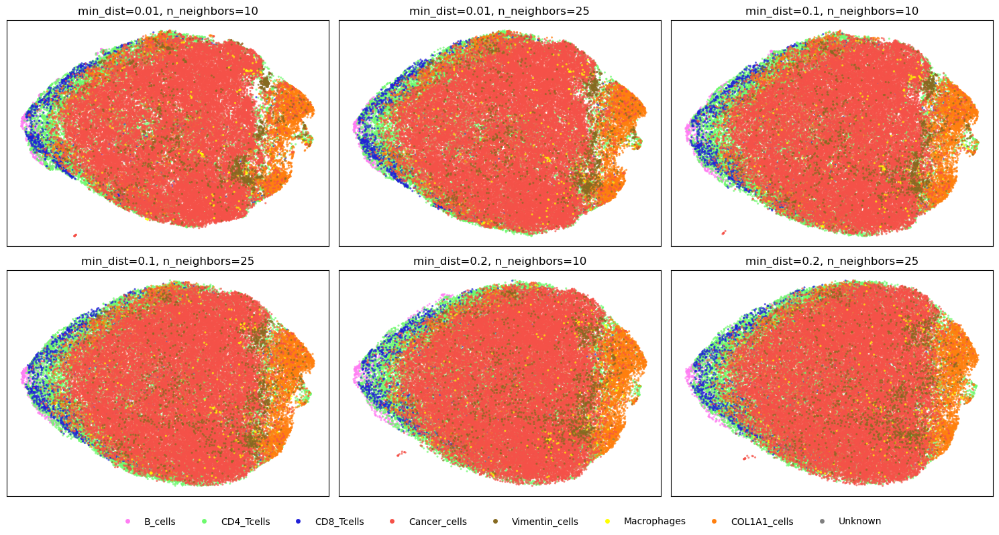

In [47]:
plot_umap_param_grid_v6(
    results_df=results, 
    labels=labels, 
    color_map=color_dict,
    param_columns=['min_dist', "n_neighbors"])

## Test 6: rawdata, all metrics

In [48]:
# load adata
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/5_filtering_done/20250302_1752_5_filtering_done_adata.h5ad")
# create data from adata
df_markers = pd.DataFrame(data=adata.X, columns=adata.var_names, index=adata.obs.CellID)
# remove non_median
# List of substrings to match
# keep_strings = ['quantile50']
# df_markers = df_markers[[col for col in df_markers.columns if any(s in col for s in keep_strings)]]
# remove_strings = ['DAPI', "_bg"]
# df_markers = df_markers[[col for col in df_markers.columns if not any(s in col for s in remove_strings)]]
# append morphodata
columns = ['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity']
df_morpho = pd.DataFrame(data=adata.obs[columns].values, columns=columns, index=adata.obs["CellID"])
df = pd.merge(left=df_markers, right=df_morpho, left_index=True, right_index=True)
#scale
scaler = StandardScaler() 
df_scaled = pd.DataFrame(data=scaler.fit_transform(df), columns=df.columns, index=df.index)
#add phenotype data
adata_pheno = ad.read_h5ad("../data/perSample/991/adata_checkpoints/6_phenotyped/20250302_1753_6_phenotyped_adata.h5ad")
df_pheno = pd.merge(left=df_scaled, right=adata_pheno.obs[["CellID","phenotype"]], left_index=True, right_on="CellID")
df_pheno.set_index("CellID", inplace=True)
#subsample
df_subsample = df_pheno.sample(100000)
#remove Unknown
df_subsample = df_subsample[df_subsample['phenotype'] != "Unknown"]
#split
data = df_subsample.iloc[:,:-1]
labels = df_subsample.iloc[:,-1]

In [49]:
data

,std_750_bg,std_647_bg,std_555_bg,std_488_bg,std_DAPI_bg,std_Vimentin,std_CD3e,std_panCK,std_CD8,std_DAPI_1,...,quantile75_CD68,quantile75_Ki67,quantile75_DAPI_2,Area,MajorAxisLength,MinorAxisLength,Eccentricity,Orientation,Extent,Solidity
CellID,,,,,,,,,,,,,,,,,,,,,
478827,-0.120878,-0.244620,-0.302513,-0.474686,-0.801455,0.229073,0.574025,-0.475199,-0.530548,-0.750365,...,1.197908,-0.201126,0.139382,-0.652085,-0.964982,-0.085009,-1.437728,-1.294369,-0.659132,-0.025148
102730,-0.406633,-0.242586,-0.103272,-0.246818,1.324615,-0.303458,0.964868,-0.522647,-0.277753,1.204297,...,-0.580302,-0.201126,0.928565,-0.761313,-0.896408,-0.529254,-0.278930,1.097351,-0.804734,0.380573
319418,0.424573,0.089372,-0.033946,0.101039,2.262566,-0.362971,1.439723,0.407177,0.868874,1.580518,...,0.976155,-0.201126,-0.045527,1.259405,0.863768,1.335564,-0.175223,0.701544,1.107657,0.685977
614220,0.059654,-0.159229,-0.114588,-0.294031,2.503712,-0.437131,-0.719388,-0.298173,-0.260414,2.102253,...,-0.161899,8.057243,0.860441,-0.240774,0.076330,-0.390027,0.736240,0.021828,-0.152964,0.178682
290557,0.202554,-0.050334,-0.174140,-0.168241,0.528635,-0.207484,-0.555641,6.996893,-0.060759,0.089122,...,0.373656,-0.201126,-0.867445,0.361687,0.434069,0.291756,0.424325,0.322971,0.275410,0.740372
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241698,1.520358,-0.096781,0.004204,-0.434588,0.235587,-0.347259,-0.683886,-0.197653,0.300350,-0.004388,...,0.122614,0.836196,-0.686075,0.682544,0.698978,0.722123,0.267458,-0.834275,0.782903,0.639842
38848,2.152154,10.557346,2.250491,2.410349,0.130236,0.520669,0.400225,-0.515644,0.638347,-0.102689,...,-1.216273,-0.201126,0.184504,-0.015491,-0.570984,0.699090,-2.280078,-0.176370,-0.173487,0.849370
329267,0.738285,0.290755,0.360877,0.453697,3.085758,0.616814,2.822788,-0.517298,4.648271,2.517007,...,0.875739,-0.201126,0.007557,1.136523,1.599415,0.609981,0.946026,-0.340092,1.671096,-2.737517


## Test 7: median only, no DAPI, no background, with morphological features

In [355]:
# load adata
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/5_filtering_done/20250302_1752_5_filtering_done_adata.h5ad")
# create data from adata
df_markers = pd.DataFrame(data=adata.X, columns=adata.var_names, index=adata.obs.CellID)
# remove non_median
# List of substrings to match
keep_strings = ['quantile50']
df_markers = df_markers[[col for col in df_markers.columns if any(s in col for s in keep_strings)]]
remove_strings = ['DAPI', "_bg"]
df_markers = df_markers[[col for col in df_markers.columns if not any(s in col for s in remove_strings)]]
# append morphodata
columns = ['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity']
df_morpho = pd.DataFrame(data=adata.obs[columns].values, columns=columns, index=adata.obs["CellID"])
df = pd.merge(left=df_markers, right=df_morpho, left_index=True, right_index=True)
#scale
scaler = StandardScaler() 
df_scaled = pd.DataFrame(data=scaler.fit_transform(df), columns=df.columns, index=df.index)
#add phenotype data
adata_pheno = ad.read_h5ad("../data/perSample/991/adata_checkpoints/6_phenotyped/20250302_1753_6_phenotyped_adata.h5ad")
df_pheno = pd.merge(left=df_scaled, right=adata_pheno.obs[["CellID","phenotype"]], left_index=True, right_on="CellID")
df_pheno.set_index("CellID", inplace=True)
#subsample
df_subsample = df_pheno.sample(100000)
#remove Unknown
df_subsample = df_subsample[df_subsample['phenotype'] != "Unknown"]
#split
data = df_subsample.iloc[:,:-1]
labels = df_subsample.iloc[:,-1]

In [359]:
data.columns

Index(['quantile50_Vimentin', 'quantile50_CD3e', 'quantile50_panCK',
       'quantile50_CD8', 'quantile50_COL1A1', 'quantile50_CD20',
       'quantile50_CD68', 'quantile50_Ki67', 'Area', 'MajorAxisLength',
       'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity'],
      dtype='object')

In [357]:
params = {'n_neighbors': [10,25], 'min_dist': [0.01, 0.1, 0.2], 'n_components': [2], 'metric': ['euclidean']}
results = run_umap_grid_settings(params, data)

UMAP grid search: 100%|██████████| 6/6 [02:38<00:00, 26.36s/it, n_neighbors=25, min_dist=0.2] 


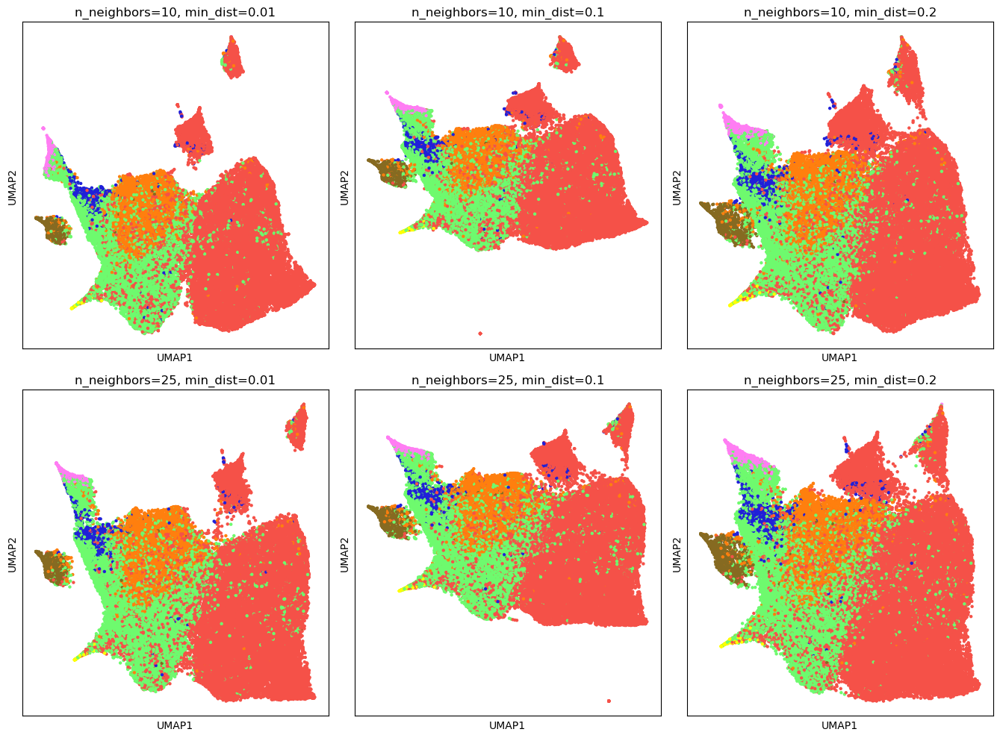

In [358]:
plot_umap_grid_results(grid_results=results, param_names=("n_neighbors", "min_dist"), color_series=labels, color_dict=color_dict)

## Test 8:  mean only, no DAPI, no background, with morphological features

In [51]:
# load adata
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/5_filtering_done/20250302_1752_5_filtering_done_adata.h5ad")
# create data from adata
df_markers = pd.DataFrame(data=adata.X, columns=adata.var_names, index=adata.obs.CellID)
# remove non_median
# List of substrings to match
keep_strings = ['mean']
df_markers = df_markers[[col for col in df_markers.columns if any(s in col for s in keep_strings)]]
remove_strings = ['DAPI', "_bg"]
df_markers = df_markers[[col for col in df_markers.columns if not any(s in col for s in remove_strings)]]
# append morphodata
columns = ['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity']
df_morpho = pd.DataFrame(data=adata.obs[columns].values, columns=columns, index=adata.obs["CellID"])
df = pd.merge(left=df_markers, right=df_morpho, left_index=True, right_index=True)
#scale
scaler = StandardScaler() 
df_scaled = pd.DataFrame(data=scaler.fit_transform(df), columns=df.columns, index=df.index)
#add phenotype data
adata_pheno = ad.read_h5ad("../data/perSample/991/adata_checkpoints/6_phenotyped/20250302_1753_6_phenotyped_adata.h5ad")
df_pheno = pd.merge(left=df_scaled, right=adata_pheno.obs[["CellID","phenotype"]], left_index=True, right_on="CellID")
df_pheno.set_index("CellID", inplace=True)
#subsample
df_subsample = df_pheno.sample(100000)
#remove Unknown
df_subsample = df_subsample[df_subsample['phenotype'] != "Unknown"]
#split
data = df_subsample.iloc[:,:-1]
labels = df_subsample.iloc[:,-1]

In [52]:
data.columns

Index(['mean_Vimentin', 'mean_CD3e', 'mean_panCK', 'mean_CD8', 'mean_COL1A1',
       'mean_CD20', 'mean_CD68', 'mean_Ki67', 'Area', 'MajorAxisLength',
       'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity'],
      dtype='object')

In [54]:
params = {'n_neighbors': [5,10,25,50], 'min_dist': [0.001, 0.01, 0.1, 0.2, 0.5], 'n_components': [2], 'metric': ['euclidean']}
results = run_umap_grid_search_df(data, params)

UMAP Grid Search: 100%|██████████| 20/20 [02:28<00:00,  7.42s/it]


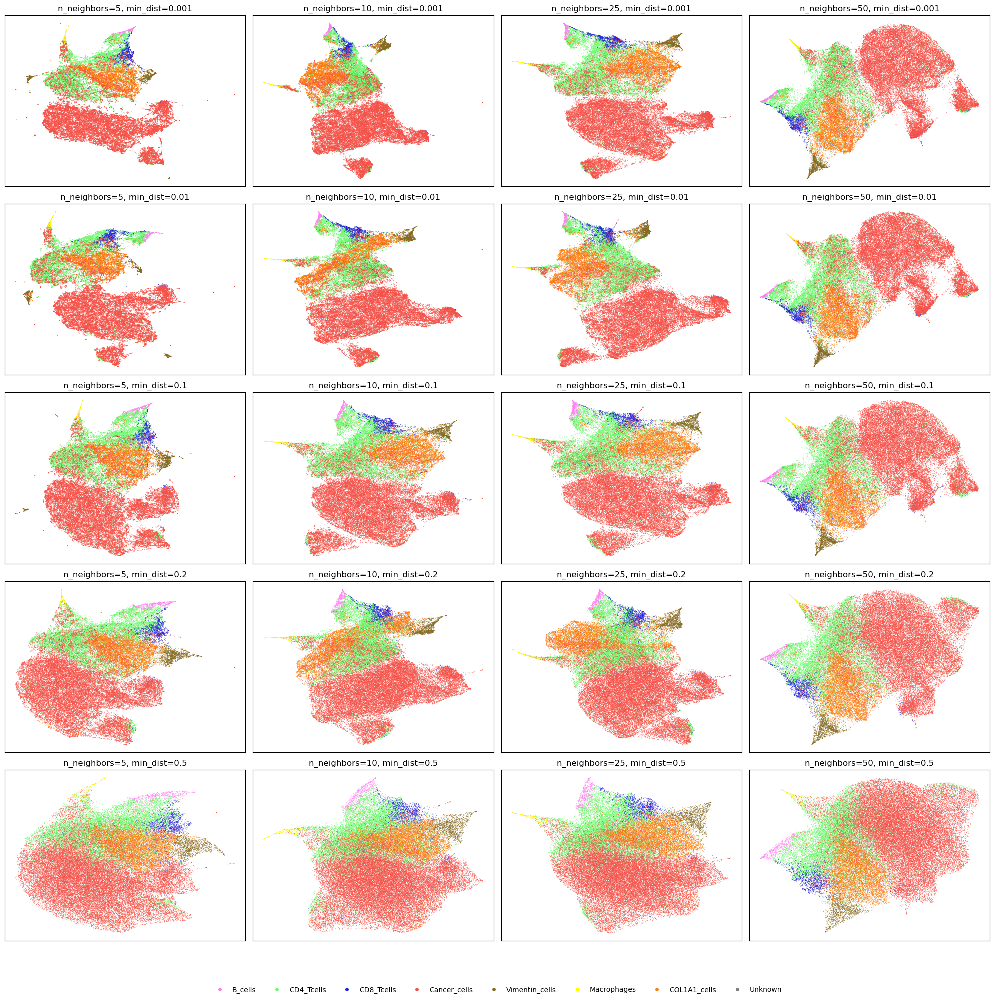

In [58]:
plot_umap_param_grid(results, labels=labels, color_map=color_dict, param_columns=['n_neighbors', 'min_dist'], ncols=4, point_size=1)

# Test umap with demo data

In [172]:
import scanpy as sc
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import umap
import matplotlib.pyplot as plt

# Load pbmc3k dataset
adata = sc.datasets.pbmc3k()
print(adata)

# Step 1: Normalize and log transform (Scanpy preprocessing)
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

# Step 2: Select highly variable genes
sc.pp.highly_variable_genes(adata, n_top_genes=2000, subset=True)

# Step 3: Scale the data using sklearn
scaler = StandardScaler()
X_scaled = scaler.fit_transform(adata.X.toarray())

AnnData object with n_obs × n_vars = 2700 × 32738
    var: 'gene_ids'


In [177]:
X_scaled.shape

(2700, 2000)

In [174]:
# Step 4: PCA using sklearn
pca = PCA(n_components=50)
X_pca = pca.fit_transform(X_scaled)

In [176]:
X_pca.shape

(2700, 50)

In [179]:
# Step 5: UMAP using sklearn
reducer = umap.UMAP(n_components=2)
X_umap = reducer.fit_transform(X_pca)

In [180]:
X_umap.shape

(2700, 2)

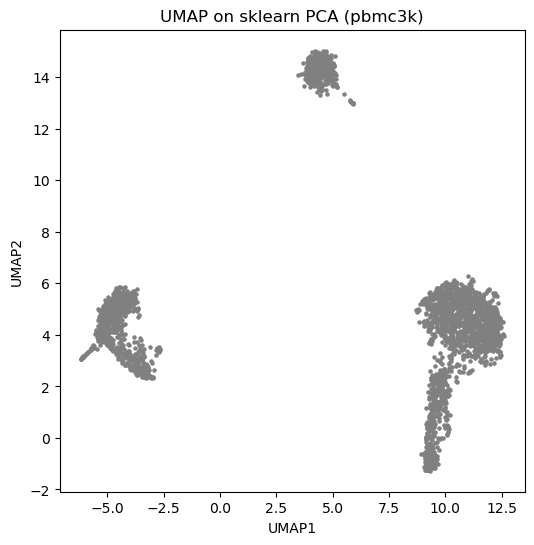

In [181]:
# Step 6: Plot the UMAP
plt.figure(figsize=(6, 6))
plt.scatter(X_umap[:, 0], X_umap[:, 1], s=5, c='gray')
plt.title("UMAP on sklearn PCA (pbmc3k)")
plt.xlabel("UMAP1")
plt.ylabel("UMAP2")
plt.show()

In [182]:
#use only top 10 PCs

# Just slice the PCA result
X_umap_PCs = reducer.fit_transform(X_pca[:, :10])  # Top 10 PCs

In [183]:
X_umap_PCs.shape

(2700, 2)

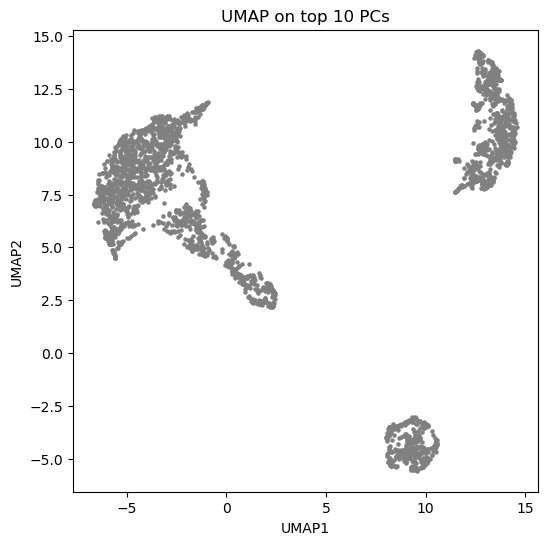

In [184]:
plt.figure(figsize=(6, 6))
plt.scatter(X_umap_PCs[:, 0], X_umap_PCs[:, 1], s=5, c='gray')
plt.title("UMAP on top 10 PCs")
plt.xlabel("UMAP1")
plt.ylabel("UMAP2")
plt.show()

# Correlation plot

In [302]:
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/5_filtering_done/20250302_1752_5_filtering_done_adata.h5ad")

In [323]:
columns

['Area',
 'MajorAxisLength',
 'MinorAxisLength',
 'Eccentricity',
 'Orientation',
 'Extent',
 'Solidity',
 'CellID']

In [324]:
adata.obs[columns]

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,Orientation,Extent,Solidity,CellID
0,1519.0,98.696620,30.646839,0.950568,-1.524977,228.651804,0.676615,1
1,1567.0,50.422862,39.687556,0.616832,0.160002,148.710678,0.975109,2
2,1025.0,40.280587,34.195207,0.528513,-0.346644,131.438600,0.927602,3
3,1315.0,61.049935,28.208869,0.886848,-1.447088,151.254834,0.947406,4
4,3656.0,84.178897,57.384893,0.731630,0.251203,243.379726,0.926743,5
...,...,...,...,...,...,...,...,...
685800,1080.0,56.372404,25.352581,0.893163,1.002754,141.610173,0.961710,685801
685801,1076.0,41.856049,34.076776,0.580666,1.330143,129.396970,0.951370,685802
685802,768.0,33.256837,29.969709,0.433488,0.983058,105.254834,0.957606,685803
685803,1042.0,45.051210,31.924524,0.705583,1.218499,133.189863,0.964815,685804


In [326]:
# Compute correlation matrix
df = pd.DataFrame(data=adata.X, columns = adata.var_names, index=adata.obs.CellID)
# df_tmp=adata.obs[columns]

df2 = pd.merge(left=df, right=adata.obs[columns], left_index=True, right_on="CellID")

In [328]:
df2.set_index("CellID", inplace=True)

In [329]:
df2

,std_750_bg,std_647_bg,std_555_bg,std_488_bg,std_DAPI_bg,std_Vimentin,std_CD3e,std_panCK,std_CD8,std_DAPI_1,...,quantile75_CD68,quantile75_Ki67,quantile75_DAPI_2,Area,MajorAxisLength,MinorAxisLength,Eccentricity,Orientation,Extent,Solidity
CellID,,,,,,,,,,,,,,,,,,,,,
1,41.461879,53.659788,49.309493,200.259604,293.016404,17.130015,39.752603,507.595592,142.687713,207.805129,...,47.0,0.0,180.00,1519.0,98.696620,30.646839,0.950568,-1.524977,228.651804,0.676615
2,40.490387,57.285263,55.572827,272.513485,100.859416,19.037045,39.202903,160.053639,95.518951,66.822572,...,74.0,0.0,150.50,1567.0,50.422862,39.687556,0.616832,0.160002,148.710678,0.975109
3,37.306977,51.420912,48.657057,202.735215,521.368069,18.545898,180.109307,614.089391,119.210731,372.585199,...,55.0,0.0,380.00,1025.0,40.280587,34.195207,0.528513,-0.346644,131.438600,0.927602
4,32.089896,46.208358,41.483179,162.604498,512.721100,52.330565,526.061306,12.027664,214.472596,365.062316,...,51.0,0.0,298.00,1315.0,61.049935,28.208869,0.886848,-1.447088,151.254834,0.947406
5,40.127534,61.024925,62.499609,348.885138,558.572462,63.805350,224.495425,253.642134,186.853325,388.263525,...,75.0,0.0,360.00,3656.0,84.178897,57.384893,0.731630,0.251203,243.379726,0.926743
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
685801,38.485352,66.591807,63.226838,430.517158,732.281149,27.139890,96.772639,263.924945,146.264609,475.066378,...,133.0,0.0,327.00,1080.0,56.372404,25.352581,0.893163,1.002754,141.610173,0.961710
685802,47.780091,59.232044,54.975240,169.889542,634.667067,38.065066,116.151500,477.983507,219.382574,361.719553,...,84.0,0.0,310.00,1076.0,41.856049,34.076776,0.580666,1.330143,129.396970,0.951370
685803,49.075153,63.727945,55.835855,159.275846,691.710118,121.683879,499.780392,21.016286,496.552850,457.859822,...,135.0,0.0,380.50,768.0,33.256837,29.969709,0.433488,0.983058,105.254834,0.957606


In [330]:
scaler = StandardScaler()
df2_scaled = pd.DataFrame(data=scaler.fit_transform(df2), columns=df2.columns, index=df2.index)

In [331]:
df2_scaled

,std_750_bg,std_647_bg,std_555_bg,std_488_bg,std_DAPI_bg,std_Vimentin,std_CD3e,std_panCK,std_CD8,std_DAPI_1,...,quantile75_CD68,quantile75_Ki67,quantile75_DAPI_2,Area,MajorAxisLength,MinorAxisLength,Eccentricity,Orientation,Extent,Solidity
CellID,,,,,,,,,,,,,,,,,,,,,
1,0.091330,-0.256761,-0.401807,-0.421929,-1.037363,-0.520188,-0.708325,0.891088,-0.263086,-1.076161,...,-0.429677,-0.201126,-1.170909,0.397527,4.232512,-0.365265,1.815555,-1.658800,2.820373,-8.303037
2,-0.068099,-0.195081,-0.241708,-0.199002,-1.726052,-0.503680,-0.711845,-0.082573,-0.572932,-1.753150,...,0.022198,-0.201126,-1.275308,0.479448,0.156851,0.734780,-0.403096,0.184494,0.275410,0.950657
3,-0.590518,-0.294852,-0.418484,-0.414291,-0.218952,-0.507932,0.190324,1.189437,-0.417303,-0.284898,...,-0.295788,-0.201126,-0.463122,-0.445576,-0.699442,0.066489,-0.990238,-0.369755,-0.274455,-0.522122
4,-1.446677,-0.383534,-0.601856,-0.538107,-0.249943,-0.215473,2.405322,-0.497276,0.208459,-0.321023,...,-0.362732,-0.201126,-0.753315,0.049363,1.054074,-0.661909,1.391944,-1.573592,0.356404,0.091843
5,-0.127645,-0.131457,-0.064652,0.036630,-0.085612,-0.116142,0.474512,0.179621,0.027032,-0.209612,...,0.038934,-0.201126,-0.533901,4.044718,3.006808,2.888133,0.360071,0.284264,3.289244,-0.548755
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
685801,-0.397139,-0.036747,-0.046063,0.288491,0.536958,-0.433538,-0.343248,0.208429,-0.239590,0.207210,...,1.009627,-0.201126,-0.650685,-0.351708,0.659159,-1.009453,1.433926,1.106428,0.049362,0.535265
685802,1.128191,-0.161960,-0.256983,-0.515630,0.187110,-0.338963,-0.219173,0.808128,0.240712,-0.337074,...,0.189559,-0.201126,-0.710847,-0.358535,-0.566429,0.052078,-0.643531,1.464577,-0.339452,0.214736
685803,1.340720,-0.085470,-0.234985,-0.548377,0.391552,0.384886,2.237055,-0.472094,2.061408,0.124585,...,1.043100,-0.201126,-0.461352,-0.884195,-1.292444,-0.447656,-1.621956,1.084882,-1.108028,0.408045


In [308]:
from scipy.cluster.hierarchy import linkage, leaves_list
from scipy.spatial.distance import squareform

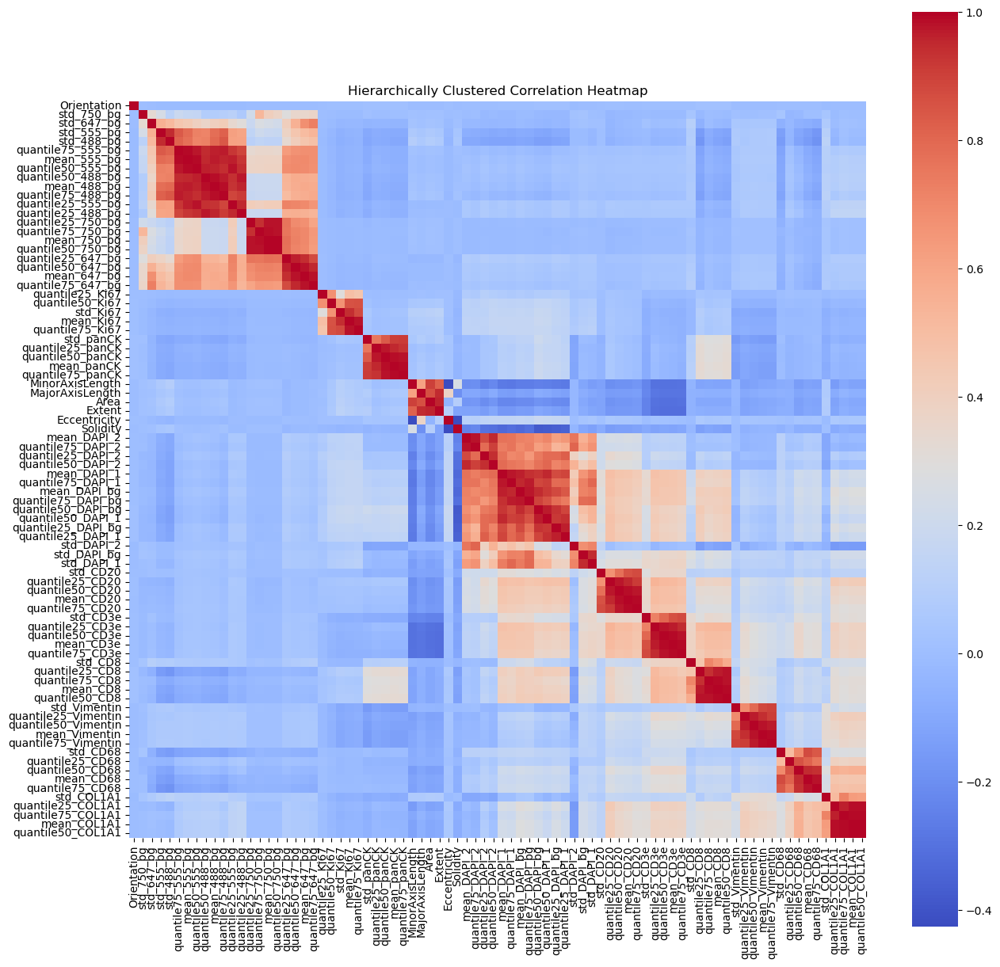

In [332]:
# Compute correlation matrix
corr = df2_scaled.corr()

# Convert correlation to distance (1 - correlation)
dist = 1 - corr.abs()  # abs() makes it cluster by strength, regardless of sign

# Perform hierarchical clustering
linkage_matrix = linkage(squareform(dist), method='average')
dendro_order = leaves_list(linkage_matrix)

# Reorder correlation matrix
corr_clustered = corr.iloc[dendro_order, dendro_order]

# Plot clustered heatmap
fig,ax = plt.subplots(figsize=(15,15))
sns.heatmap(corr_clustered, annot=False, cmap='coolwarm', square=True,
            xticklabels=corr_clustered.columns, yticklabels=corr_clustered.columns)
plt.title("Hierarchically Clustered Correlation Heatmap")
plt.show()

# Final, all cells

In [74]:
# load adata
adata = ad.read_h5ad("../data/perSample/991/adata_checkpoints/5_filtering_done/20250302_1752_5_filtering_done_adata.h5ad")
# create data from adata
df_markers = pd.DataFrame(data=adata.X, columns=adata.var_names, index=adata.obs.CellID)
# remove non_median
# List of substrings to match
keep_strings = ['mean']
df_markers = df_markers[[col for col in df_markers.columns if any(s in col for s in keep_strings)]]
remove_strings = ['DAPI', "_bg"]
df_markers = df_markers[[col for col in df_markers.columns if not any(s in col for s in remove_strings)]]
# append morphodata
columns = ['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity']
df_morpho = pd.DataFrame(data=adata.obs[columns].values, columns=columns, index=adata.obs["CellID"])
df = pd.merge(left=df_markers, right=df_morpho, left_index=True, right_index=True)
#scale
scaler = StandardScaler() 
df_scaled = pd.DataFrame(data=scaler.fit_transform(df), columns=df.columns, index=df.index)
#add phenotype data
adata_pheno = ad.read_h5ad("../data/perSample/991/adata_checkpoints/6_phenotyped/20250302_1753_6_phenotyped_adata.h5ad")
df_pheno = pd.merge(left=df_scaled, right=adata_pheno.obs[["CellID","phenotype"]], left_index=True, right_on="CellID")
df_pheno.set_index("CellID", inplace=True)
#subsample
# df_pheno = df_pheno.sample(100000)
#remove Unknown
df_pheno = df_pheno[df_pheno['phenotype'] != "Unknown"]
#split
data = df_pheno.iloc[:,:-1]
labels = df_pheno.iloc[:,-1]

In [75]:
data.shape

(392114, 15)

In [76]:
params = {'n_neighbors': [25], 'min_dist': [0.01], 'n_components': [2], 'metric': ['euclidean']}
results = run_umap_grid_search_df(data, params)

UMAP Grid Search: 100%|██████████| 1/1 [01:14<00:00, 74.16s/it]


In [71]:
results.iloc[0,0].shape

(64519, 2)

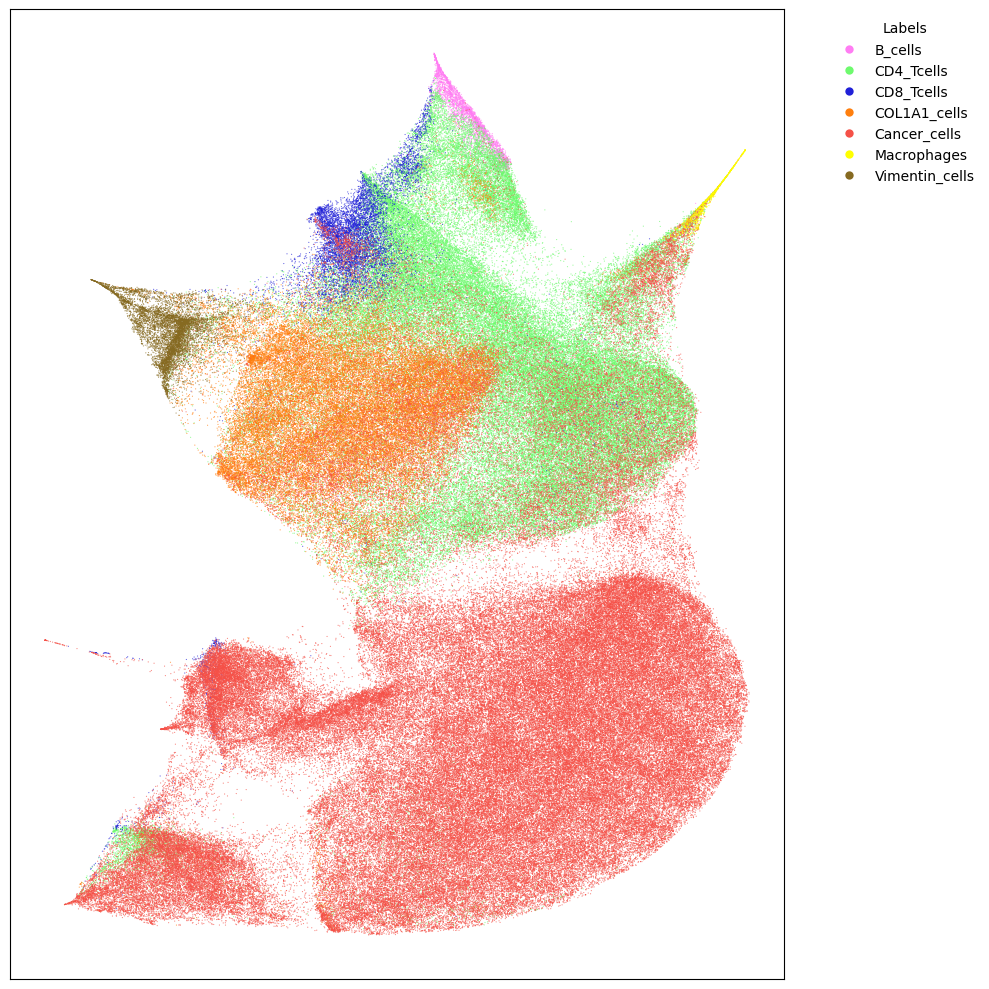

In [86]:
plot_single_umap_result(
    results.iloc[0,0], 
    labels=labels, 
    color_map=color_dict, 
    point_size=0.7,
    figsize=(10,10)
    )

# do the same for 992

In [87]:
# load adata
adata = ad.read_h5ad("../data/perSample/992/adata_checkpoints/5_filtering_done/20250303_1101_5_filtering_done_adata.h5ad")
# create data from adata
df_markers = pd.DataFrame(data=adata.X, columns=adata.var_names, index=adata.obs.CellID)
# remove non_median
# List of substrings to match
keep_strings = ['mean']
df_markers = df_markers[[col for col in df_markers.columns if any(s in col for s in keep_strings)]]
remove_strings = ['DAPI', "_bg"]
df_markers = df_markers[[col for col in df_markers.columns if not any(s in col for s in remove_strings)]]
# append morphodata
columns = ['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity']
df_morpho = pd.DataFrame(data=adata.obs[columns].values, columns=columns, index=adata.obs["CellID"])
df = pd.merge(left=df_markers, right=df_morpho, left_index=True, right_index=True)
#scale
scaler = StandardScaler() 
df_scaled = pd.DataFrame(data=scaler.fit_transform(df), columns=df.columns, index=df.index)
#add phenotype data
adata_pheno = ad.read_h5ad("../data/perSample/992/adata_checkpoints/6_phenotyped/20250303_1112_6_phenotyped_adata.h5ad")
df_pheno = pd.merge(left=df_scaled, right=adata_pheno.obs[["CellID","phenotype"]], left_index=True, right_on="CellID")
df_pheno.set_index("CellID", inplace=True)
#subsample
# df_pheno = df_pheno.sample(100000)
#remove Unknown
df_pheno = df_pheno[df_pheno['phenotype'] != "Unknown"]
#split
data = df_pheno.iloc[:,:-1]
labels = df_pheno.iloc[:,-1]

In [90]:
data.shape

(870077, 15)

In [88]:
params = {'n_neighbors': [25], 'min_dist': [0.01], 'n_components': [2], 'metric': ['euclidean']}
results = run_umap_grid_search_df(data, params)

UMAP Grid Search: 100%|██████████| 1/1 [22:03<00:00, 1323.22s/it]


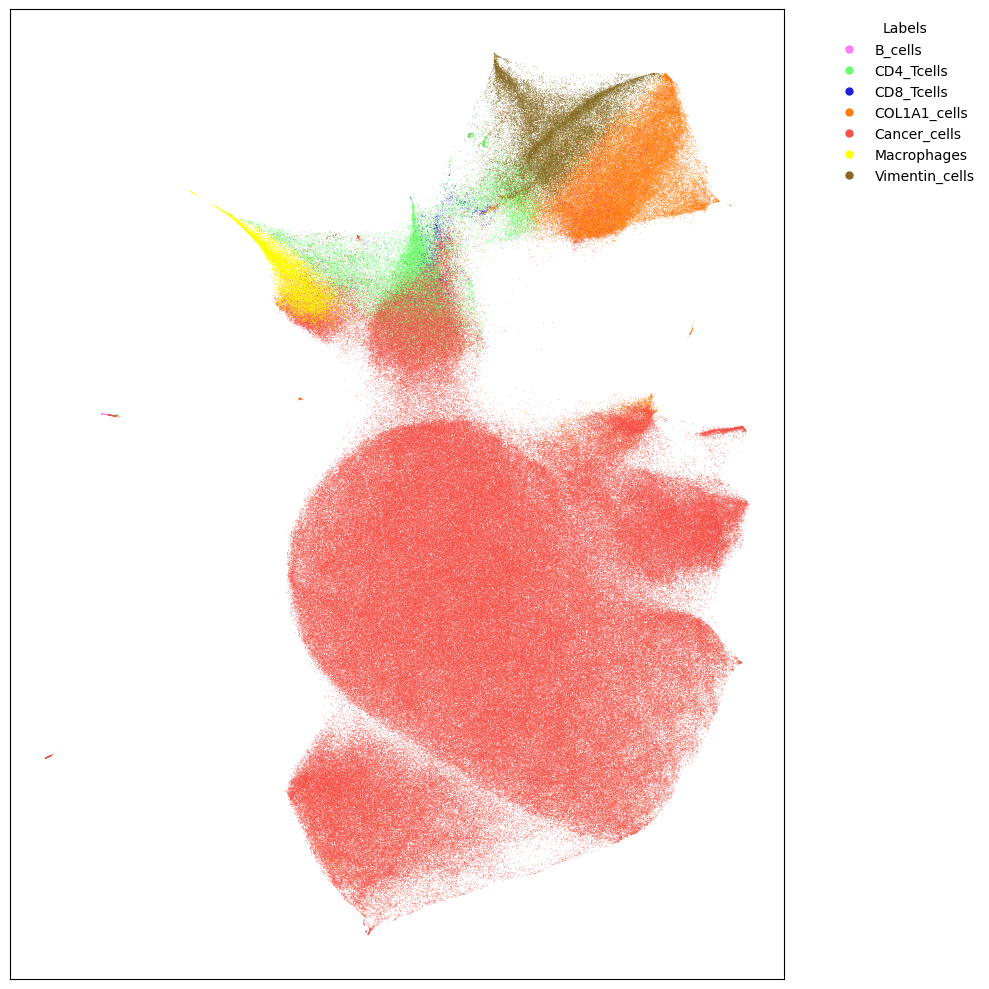

In [93]:
plot_single_umap_result(
    results.iloc[0,0], 
    labels=labels, 
    color_map=color_dict, 
    point_size=0.3,
    figsize=(10,10)
    )